<a href="https://colab.research.google.com/github/dhiksha08/ChurnWiz/blob/main/Telecom_churn_Prediction_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score
import scipy.stats as stats
from imblearn.over_sampling import SMOTE
from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
from collections import Counter

from sklearn.metrics import accuracy_score
import pickle
import os
from sklearn.model_selection import KFold
import multiprocessing
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn import feature_selection
from sklearn import model_selection
from sklearn import metrics

from sklearn.linear_model import LogisticRegressionCV, RidgeClassifierCV, SGDClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import AdaBoostClassifier, BaggingClassifier, GradientBoostingClassifier, RandomForestClassifier
from xgboost import XGBClassifier

In [ ]:
#DHIKSHI
train=pd.read_csv("train (3).csv")
train.head()

,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
0,OH,107,area_code_415,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,no
1,NJ,137,area_code_415,no,no,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,no
2,OH,84,area_code_408,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,no
3,OK,75,area_code_415,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,no
4,MA,121,area_code_510,no,yes,24,218.2,88,37.09,348.5,108,29.62,212.6,118,9.57,7.5,7,2.03,3,no


In [ ]:
train[train['churn']=='yes']

,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
8,IN,65,area_code_415,no,no,0,129.1,137,21.95,228.5,83,19.42,208.8,111,9.40,12.7,6,3.43,4,yes
12,NY,161,area_code_415,no,no,0,332.9,67,56.59,317.8,97,27.01,160.6,128,7.23,5.4,9,1.46,4,yes
17,CO,77,area_code_408,no,no,0,62.4,89,10.61,169.9,121,14.44,209.6,64,9.43,5.7,6,1.54,5,yes
26,AZ,12,area_code_408,no,no,0,249.6,118,42.43,252.4,119,21.45,280.2,90,12.61,11.8,3,3.19,1,yes
32,MD,135,area_code_408,yes,yes,41,173.1,85,29.43,203.9,107,17.33,122.2,78,5.50,14.6,15,3.94,0,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4203,NH,114,area_code_510,yes,yes,28,136.4,93,23.19,170.0,90,14.45,191.5,73,8.62,14.6,4,3.94,2,yes
4208,ME,90,area_code_415,no,no,0,104.0,104,17.68,170.9,106,14.53,158.8,99,7.15,8.7,5,2.35,4,yes
4213,NM,137,area_code_408,yes,no,0,312.4,110,53.11,231.1,73,19.64,120.1,78,5.40,10.6,2,2.86,1,yes
4243,ND,140,area_code_510,no,no,0,244.7,115,41.60,258.6,101,21.98,231.3,112,10.41,7.5,6,2.03,1,yes


In [ ]:
train.columns.values

array(['state', 'account_length', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'], dtype=object)

In [ ]:
train.dtypes

state                             object
account_length                     int64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

In [ ]:
print('Shape of Train Data: ', train.shape)

Shape of Train Data:  (4250, 20)


In [ ]:
string_columns = train.select_dtypes(include=['object'])
print(string_columns)

     state      area_code international_plan voice_mail_plan churn
0       OH  area_code_415                 no             yes    no
1       NJ  area_code_415                 no              no    no
2       OH  area_code_408                yes              no    no
3       OK  area_code_415                yes              no    no
4       MA  area_code_510                 no             yes    no
...    ...            ...                ...             ...   ...
4245    MT  area_code_415                 no              no    no
4246    WV  area_code_408                 no              no    no
4247    NC  area_code_408                 no              no    no
4248    HI  area_code_408                 no             yes    no
4249    VT  area_code_415                 no             yes    no

[4250 rows x 5 columns]


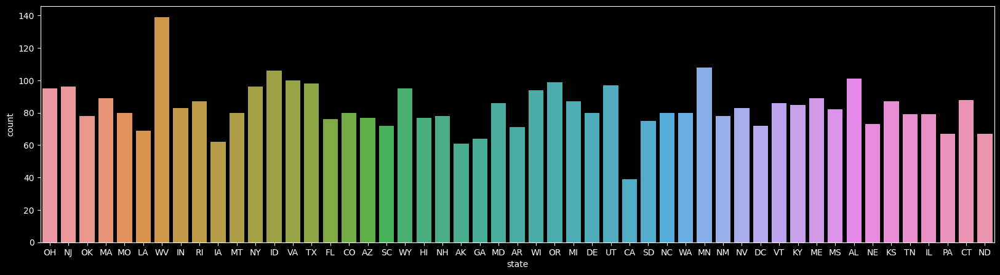

In [ ]:
plt.style.use('dark_background')
for column in string_columns:
    if(column=="state"):
      plt.figure(figsize=(20,5))
      sns.countplot(x=column, data=string_columns)
      plt.show()

In [ ]:
train.isnull().sum()

state                            0
account_length                   0
area_code                        0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_minutes                0
total_day_calls                  0
total_day_charge                 0
total_eve_minutes                0
total_eve_calls                  0
total_eve_charge                 0
total_night_minutes              0
total_night_calls                0
total_night_charge               0
total_intl_minutes               0
total_intl_calls                 0
total_intl_charge                0
number_customer_service_calls    0
churn                            0
dtype: int64

In [ ]:
import plotly.offline as py
trace = go.Pie(labels = train["churn"].value_counts().keys().tolist(),
               values = train["churn"].value_counts().values.tolist(),
               marker = dict(colors = ['royalblue','lime'],
                             line = dict(color = "white", width =  1.3)
                            ),
               rotation = 90,
               hoverinfo = "label+value+text",
               hole = .5
              )
layout = go.Layout(dict(title = "Customer churn in training data",
                        plot_bgcolor = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                       )
                  )
data = [trace]
fig = go.Figure(data = data, layout = layout)
py.iplot(fig)

/var/folders/n5/vm862s_n5p751f9xypymdzw40000gn/T/ipykernel_3345/341820176.py:2: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



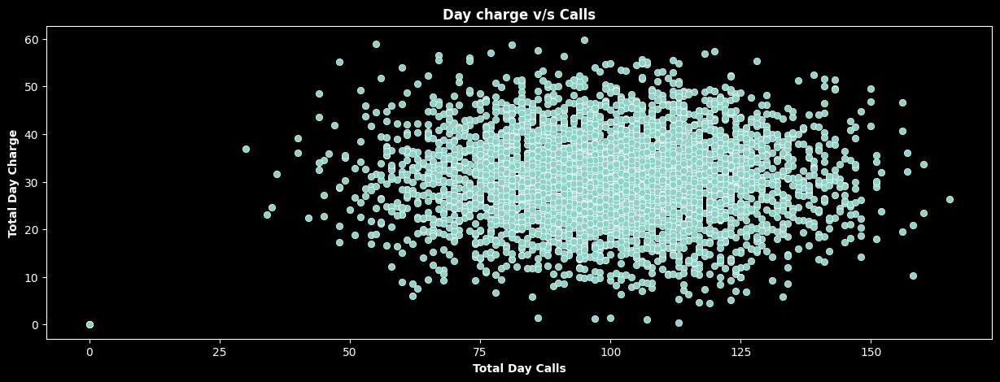

In [ ]:
fig, ax = plt.subplots(figsize=(15, 5))
sns.scatterplot(data=train, x='total_day_calls', y='total_day_charge', palette='viridis')
plt.xlabel('Total Day Calls', fontsize=10, fontweight='bold')
plt.ylabel('Total Day Charge', fontsize=10, fontweight='bold')
plt.title('Day charge v/s Calls', fontsize=12, fontweight='bold')
plt.show()

In [ ]:
cat_cols = ['state','area_code','international_plan','voice_mail_plan','churn']

#converts the selected columns to the 'category' data type using .astype('category')
train[cat_cols] = train[cat_cols].astype('category')

train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4250 entries, 0 to 4249
Data columns (total 20 columns):
 #   Column                         Non-Null Count  Dtype   
---  ------                         --------------  -----   
 0   state                          4250 non-null   category
 1   account_length                 4250 non-null   int64   
 2   area_code                      4250 non-null   category
 3   international_plan             4250 non-null   category
 4   voice_mail_plan                4250 non-null   category
 5   number_vmail_messages          4250 non-null   int64   
 6   total_day_minutes              4250 non-null   float64 
 7   total_day_calls                4250 non-null   int64   
 8   total_day_charge               4250 non-null   float64 
 9   total_eve_minutes              4250 non-null   float64 
 10  total_eve_calls                4250 non-null   int64   
 11  total_eve_charge               4250 non-null   float64 
 12  total_night_minutes            425

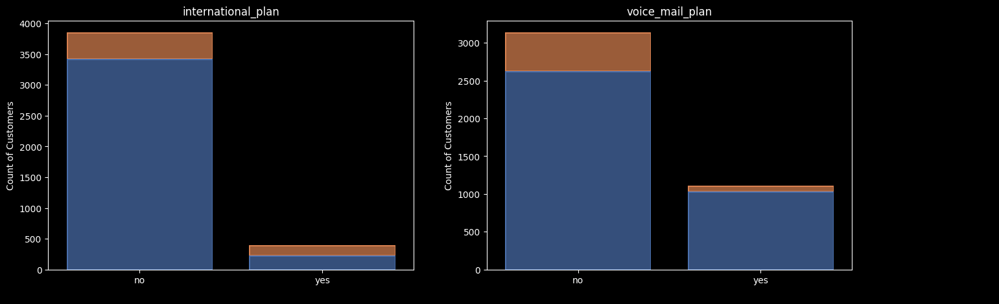

In [ ]:
import seaborn.objects as so
fig, ax = plt.subplots(1,2,figsize=(16,5))

for col,subplot in zip(cat_cols[2:-1], ax.flatten()):
    f = (
        so.Plot(train, x=col, color='churn')
        .add(so.Bar(), so.Count(), so.Stack())
        .label(x=" ", y="Count of Customers", title=col)
        .on(subplot).plot()
    )

plt.show()

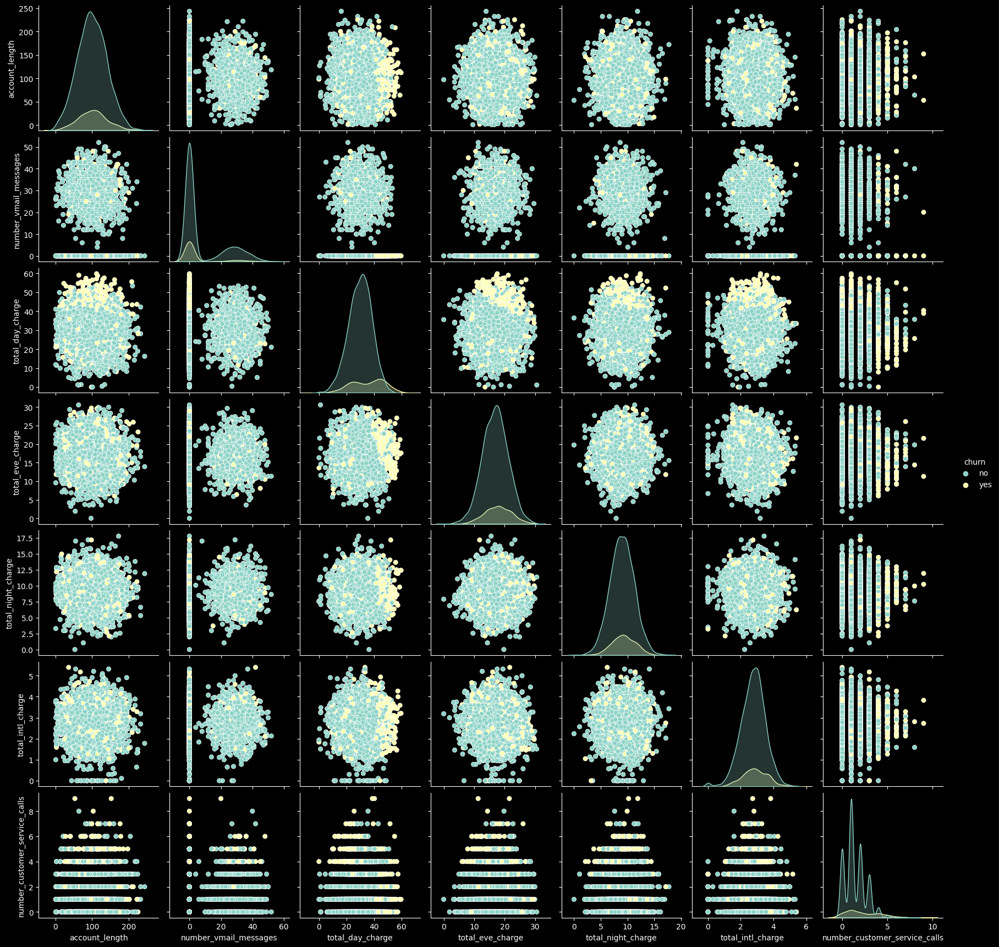

In [ ]:
sns.pairplot(train,vars=['account_length','number_vmail_messages', 'total_day_charge','total_eve_charge','total_night_charge','total_intl_charge','number_customer_service_calls'],hue='churn')

OUTLIER CHECK

In [ ]:
out=[]
def Zscore_outlier(df):
    m = np.mean(df)
    sd = np.std(df)
    for i in df:
        z = (i-m)/sd
        if np.abs(z) > 3:
            out.append(i)
    print("Outliers:",out)
Zscore_outlier(train['total_intl_charge'])


Outliers: [5.4, 0.0, 5.1, 0.0, 0.0, 0.0, 0.35, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.11, 5.21, 5.18, 0.0, 5.32, 0.0, 0.0, 0.3, 5.32]


In [ ]:
out=[]
def iqr_outliers(df):
    q1 = df.quantile(0.25)
    q3 = df.quantile(0.75)
    iqr = q3-q1
    Lower_tail = q1 - 1.5 * iqr
    Upper_tail = q3 + 1.5 * iqr
    for i in df:
        if i > Upper_tail or i < Lower_tail:
            out.append(i)
    print("Outliers:",out)
iqr_outliers(train['number_vmail_messages'])

Outliers: [41, 41, 46, 42, 43, 41, 48, 41, 45, 41, 46, 43, 42, 45, 41, 43, 42, 42, 42, 42, 43, 47, 44, 41, 44, 49, 44, 43, 42, 47, 42, 42, 43, 45, 42, 42, 45, 45, 41, 42, 43, 46, 44, 50, 44, 41, 50, 42, 47, 44, 43, 41, 44, 43, 42, 43, 41, 46, 45, 49, 46, 49, 41, 41, 42, 45, 42, 42, 43, 41, 41, 41, 47, 41, 46, 45, 46, 45, 48, 43, 45, 48, 52, 48, 43, 41]


In [ ]:
num_cols = train.select_dtypes(include=['int','float']).columns
i = ['tr'+str(n) for n in range(1,16)]

fig = make_subplots(rows=5, cols=3,
                    subplot_titles=[f'{col} Box Plot' for col in num_cols],
                   vertical_spacing=0.03)

for index,(col,trace) in enumerate(zip(num_cols, i)):
    trace = go.Box(y=train[col], boxmean=True, name=col)
    fig.add_trace(trace, row=(index//3)+1, col=(index%3)+1)

fig.update_layout(height=2000, width=1000,
                  title_text="Outlier Check in Numerical Columns",
                  showlegend=False)
fig.show()

REPLACING OUTLIERS WITH MEDIAN

In [ ]:
def replace_outliers(df, cols):
    for col in cols:
        q1 = df[col].quantile(0.25)
        q3 = df[col].quantile(0.75)
        iqr = q3-q1

        lower_bound = q1-(1.5*iqr)
        upper_bound = q3+(1.5*iqr)

        median = df[col].median()

        df[col] = np.where(df[col]<lower_bound, median, df[col])
        df[col] = np.where(df[col]>upper_bound, median, df[col])

replace_outliers(train,num_cols)

VISUALISING AFTER REPLACING OUTLIERS

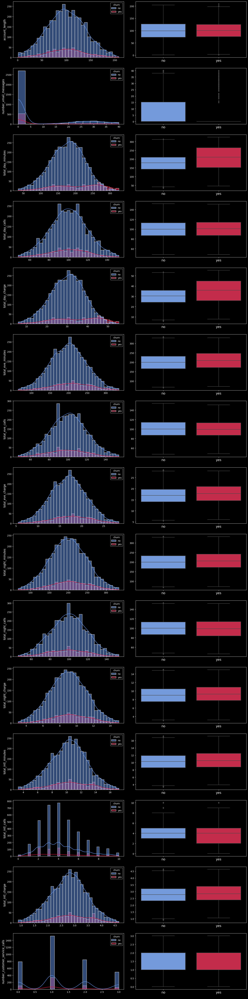

In [ ]:
fig, ax = plt.subplots(15,2,figsize=(15,60))
i=0
color_dict = {'no': matplotlib.colors.to_rgba('cornflowerblue', 0.3),
              'yes': matplotlib.colors.to_rgba('crimson', 1)}
for col in num_cols:
    sns.histplot(data=train, x=col, hue='churn', ax=ax[i, 0], legend=True,
                palette=color_dict, kde=True, fill=True)
    sns.boxplot(data=train, y=col, x='churn', ax=ax[i,1],
               palette=('cornflowerblue', 'crimson'))
    ax[i,0].set_ylabel(col, fontsize=12)
    ax[i,0].set_xlabel(' ')
    ax[i,1].set_xlabel(' ')
    ax[i,1].set_ylabel(' ')
    ax[i,1].xaxis.set_tick_params(labelsize=14)
    i += 1
plt.style.use('dark_background')
plt.tight_layout()
plt.show()

CORRELATION

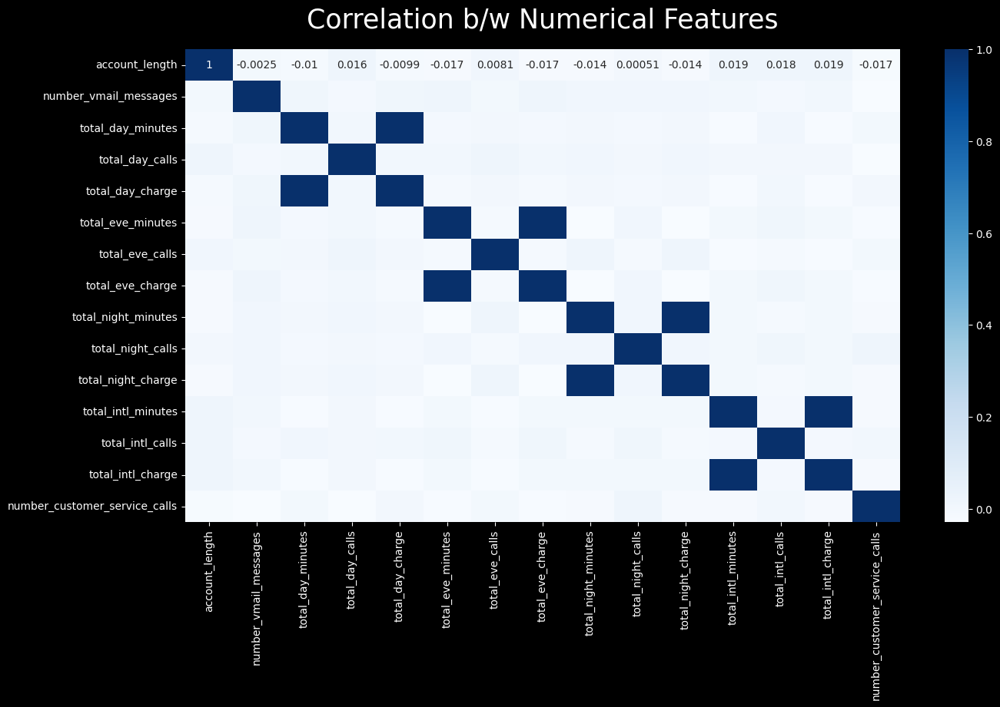

In [ ]:
table = train[num_cols].corr()
plt.figure(figsize=[15,8])
plt.title("Correlation b/w Numerical Features", size=25, pad=20)
sns.heatmap(table, cmap='Blues', annot=True)
plt.show()

REMOVING FULLY CORRELATED COLUMNS

In [ ]:
for data in [train]:
    data.drop(columns=['total_day_charge',
                       'total_eve_charge',
                      'total_night_charge',
                      'total_intl_charge'], inplace=True)

train.head()

,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_eve_minutes,total_eve_calls,total_night_minutes,total_night_calls,total_intl_minutes,total_intl_calls,number_customer_service_calls,churn
0,OH,107.0,area_code_415,no,yes,26.0,161.6,123.0,195.5,103.0,254.4,103.0,13.7,3.0,1.0,no
1,NJ,137.0,area_code_415,no,no,0.0,243.4,114.0,121.2,110.0,162.6,104.0,12.2,5.0,0.0,no
2,OH,84.0,area_code_408,yes,no,0.0,299.4,71.0,200.7,88.0,196.9,89.0,6.6,7.0,2.0,no
3,OK,75.0,area_code_415,yes,no,0.0,166.7,113.0,148.3,122.0,186.9,121.0,10.1,3.0,3.0,no
4,MA,121.0,area_code_510,no,yes,24.0,218.2,88.0,200.7,108.0,212.6,118.0,7.5,7.0,3.0,no


In [ ]:
train['area_code'].value_counts()

area_code_415    2108
area_code_408    1086
area_code_510    1056
Name: area_code, dtype: int64

In [ ]:
len(train['state'].value_counts())

51

<Axes: xlabel='number_customer_service_calls', ylabel='count'>

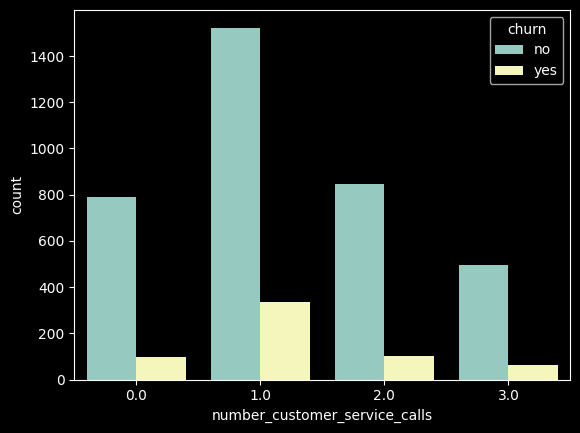

In [ ]:
sns.countplot(x="number_customer_service_calls", hue="churn", data=train)

OVERSAMPLING USING SMOTE

In [ ]:
#DHIKSHI
train=pd.read_csv("train (3).csv")
train.head()

,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
0,OH,107,area_code_415,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,no
1,NJ,137,area_code_415,no,no,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,no
2,OH,84,area_code_408,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,no
3,OK,75,area_code_415,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,no
4,MA,121,area_code_510,no,yes,24,218.2,88,37.09,348.5,108,29.62,212.6,118,9.57,7.5,7,2.03,3,no


In [ ]:
from sklearn.preprocessing import OneHotEncoder

# Create a dictionary to store one-hot encoder instances
one_hot_encoder_dict = {}

# Create a new DataFrame to store one-hot encoded columns
encoded_df = pd.DataFrame()

# Perform one-hot encoding for training data
for column in string_columns:
    encoder = OneHotEncoder(drop='first',sparse_output=False)
    encoded_data = encoder.fit_transform(train[[column]])
    new_columns = [f"{column}_{category}" for category in encoder.get_feature_names_out()]
    # Concatenate the one-hot encoded data to the new DataFrame
    encoded_df = pd.concat([encoded_df, pd.DataFrame(encoded_data, columns=new_columns)], axis=1)

    one_hot_encoder_dict[column] = encoder

# Concatenate the new DataFrame to the original DataFrame
train = pd.concat([train, encoded_df], axis=1)

# Drop the original columns that were one-hot encoded
train = train.drop(string_columns, axis=1)

# Save the one-hot encoder instances as binary files
for column, encoder in one_hot_encoder_dict.items():
    with open(f'{column}_one_hot_encoder.pkl', 'wb') as file:
        pickle.dump(encoder, file)



In [ ]:
train.columns

Index(['account_length', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'state_state_AL', 'state_state_AR',
       'state_state_AZ', 'state_state_CA', 'state_state_CO', 'state_state_CT',
       'state_state_DC', 'state_state_DE', 'state_state_FL', 'state_state_GA',
       'state_state_HI', 'state_state_IA', 'state_state_ID', 'state_state_IL',
       'state_state_IN', 'state_state_KS', 'state_state_KY', 'state_state_LA',
       'state_state_MA', 'state_state_MD', 'state_state_ME', 'state_state_MI',
       'state_state_MN', 'state_state_MO', 'state_state_MS', 'state_state_MT',
       'state_state_NC', 'state_state_ND', 'state_state_NE', 'state_state_NH',
       'state_state_NJ', 'state_state_NM', '

In [ ]:
"""   churn = 1 it means churn yes churn=0 means churn no"""

'   churn = 1 it means churn yes churn=0 means churn no'

In [ ]:
train.rename(columns={'churn_churn_yes': 'churn'}, inplace=True)

In [ ]:
train['churn'].value_counts()

0.0    3652
1.0     598
Name: churn, dtype: int64

In [ ]:
X = train.drop(columns='churn', axis=1)
Y = train['churn']
X.isnull().sum()

account_length                               0
number_vmail_messages                        0
total_day_minutes                            0
total_day_calls                              0
total_day_charge                             0
                                            ..
state_state_WY                               0
area_code_area_code_area_code_415            0
area_code_area_code_area_code_510            0
international_plan_international_plan_yes    0
voice_mail_plan_voice_mail_plan_yes          0
Length: 69, dtype: int64

In [ ]:
print(X.shape,Y.shape)
smote = SMOTE(random_state=42)
x_smote, y_smote = smote.fit_resample(X, Y)
y_smote.value_counts()

(4250, 69) (4250,)


0.0    3652
1.0    3652
Name: churn, dtype: int64

In [ ]:
from sklearn.datasets import make_classification

oversampled_data = pd.DataFrame(data=x_smote,columns=x_smote.columns)
oversampled_data['churn']=y_smote
oversampled_data.shape
oversampled_data =oversampled_data.sample(frac=1)
print(Counter(y_smote),oversampled_data.shape)

Counter({0.0: 3652, 1.0: 3652}) (7304, 70)


In [ ]:
x=oversampled_data.drop(['churn'],axis=1)
y=oversampled_data['churn']

In [ ]:
x.head()

,account_length,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,...,state_state_VA,state_state_VT,state_state_WA,state_state_WI,state_state_WV,state_state_WY,area_code_area_code_area_code_415,area_code_area_code_area_code_510,international_plan_international_plan_yes,voice_mail_plan_voice_mail_plan_yes
262,39,0,60.4,158,10.27,306.2,120,26.03,123.9,46,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2860,161,0,166.2,125,28.25,279.4,78,23.75,181.0,85,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1417,96,29,150.0,91,25.50,159.4,75,13.55,228.1,55,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
609,151,26,196.5,98,33.41,175.8,111,14.94,221.8,124,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
1903,88,0,166.7,61,28.34,179.3,88,15.24,242.7,131,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [ ]:
x.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7304 entries, 262 to 3487
Data columns (total 69 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   account_length                             7304 non-null   int64  
 1   number_vmail_messages                      7304 non-null   int64  
 2   total_day_minutes                          7304 non-null   float64
 3   total_day_calls                            7304 non-null   int64  
 4   total_day_charge                           7304 non-null   float64
 5   total_eve_minutes                          7304 non-null   float64
 6   total_eve_calls                            7304 non-null   int64  
 7   total_eve_charge                           7304 non-null   float64
 8   total_night_minutes                        7304 non-null   float64
 9   total_night_calls                          7304 non-null   int64  
 10  total_night_charge    

In [ ]:
from sklearn.preprocessing import StandardScaler

# Assuming X contains only the float variables you want to scale

# List of float numerical columns
float_numerical_columns = [
    'account_length', 'number_vmail_messages', 'total_day_minutes', 'total_day_calls',
    'total_eve_minutes', 'total_eve_calls', 'total_night_minutes', 'total_night_calls',
    'total_intl_minutes', 'total_intl_calls', 'number_customer_service_calls','total_day_charge','total_eve_charge',
    'total_night_charge','total_intl_charge'
]

# Create a StandardScaler object
scaler = StandardScaler()

# Apply standard scaling to the float numerical columns in X
x[float_numerical_columns] = scaler.fit_transform(x[float_numerical_columns])

with open('standard_scaler.pkl', 'wb') as file:
    pickle.dump(scaler, file)
# Now, X contains the scaled float numerical features
x.head()

,account_length,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,...,state_state_VA,state_state_VT,state_state_WA,state_state_WI,state_state_WV,state_state_WY,area_code_area_code_area_code_415,area_code_area_code_area_code_510,international_plan_international_plan_yes,voice_mail_plan_voice_mail_plan_yes
262,-1.644244,-0.492932,-2.149518,3.059471,-2.149363,2.064486,1.073529,2.065150,-1.634789,-2.769852,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2860,1.585690,-0.492932,-0.436957,1.315675,-0.437381,1.522355,-1.160920,1.522542,-0.449285,-0.735060,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1417,-0.135176,1.937940,-0.699183,-0.480963,-0.699224,-0.905101,-1.320523,-0.904911,0.528600,-2.300285,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
609,1.320942,1.686470,0.053502,-0.111067,0.053934,-0.573349,0.594718,-0.574111,0.397800,1.299732,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
1903,-0.346975,-0.492932,-0.428864,-2.066232,-0.428811,-0.502548,-0.628908,-0.502715,0.831724,1.664952,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [ ]:
models=[
    #Ensemble
    RandomForestClassifier(),

    #Linear Models
    LogisticRegressionCV(max_iter=1000),

    #Nearest Neighbour
    KNeighborsClassifier(),

    #XGBoost
    XGBClassifier()
]

metrics_cols = ['model_name','test_accuracy','test_precision','test_recall','test_f1']

model_name=[]
test_acuracy=[]
test_precision=[]
test_recall=[]
test_f1=[]

In [ ]:
x_train,x_test,y_train,y_test=train_test_split(x, y, test_size=0.2, random_state=42)

In [ ]:
# Model Evaluation

scoring = ['accuracy','precision', 'recall', 'f1']

for model in models:
    cv_results = model_selection.cross_validate(model, x, y, cv=5,
                                                scoring=scoring, return_train_score=True)
    model_name.append(model.__class__.__name__)
    test_acuracy.append(round(cv_results['test_accuracy'].mean(),3)*100)
    test_precision.append(round(cv_results['test_precision'].mean(),3)*100)
    test_recall.append(round(cv_results['test_recall'].mean(),3)*100)
    test_f1.append(round(cv_results['test_f1'].mean(),3)*100)

metrics_data = [model_name, test_acuracy, test_precision, test_recall, test_f1]
m = {n:m for n,m in zip(metrics_cols,metrics_data)}
model_metrics = pd.DataFrame(m)
model_metrics = model_metrics.sort_values('test_accuracy', ascending=False)
metrics_styled = model_metrics.style.background_gradient(subset=['test_accuracy', 'test_f1'], cmap='summer')
metrics_styled

,model_name,test_accuracy,test_precision,test_recall,test_f1
3,XGBClassifier,97.400000,98.600000,96.200000,97.400000
0,RandomForestClassifier,97.300000,98.200000,96.400000,97.300000
2,KNeighborsClassifier,85.100000,77.700000,98.500000,86.800000
1,LogisticRegressionCV,76.900000,76.500000,77.800000,77.100000


In [ ]:
model_metrics.to_csv("model_metrics.csv", index=False)


In [ ]:
final_model=XGBClassifier()
final_model.fit(x_train, y_train)
train_pred = final_model.predict(x_train)
test_pred = final_model.predict(x_test)
accuracy_score(test_pred, y_test)

0.974674880219028

In [ ]:
final_model.get_params()

{'objective': 'binary:logistic',
 'base_score': None,
 'booster': None,
 'callbacks': None,
 'colsample_bylevel': None,
 'colsample_bynode': None,
 'colsample_bytree': None,
 'device': None,
 'early_stopping_rounds': None,
 'enable_categorical': False,
 'eval_metric': None,
 'feature_types': None,
 'gamma': None,
 'grow_policy': None,
 'importance_type': None,
 'interaction_constraints': None,
 'learning_rate': None,
 'max_bin': None,
 'max_cat_threshold': None,
 'max_cat_to_onehot': None,
 'max_delta_step': None,
 'max_depth': None,
 'max_leaves': None,
 'min_child_weight': None,
 'missing': nan,
 'monotone_constraints': None,
 'multi_strategy': None,
 'n_estimators': None,
 'n_jobs': None,
 'num_parallel_tree': None,
 'random_state': None,
 'reg_alpha': None,
 'reg_lambda': None,
 'sampling_method': None,
 'scale_pos_weight': None,
 'subsample': None,
 'tree_method': None,
 'validate_parameters': None,
 'verbosity': None}

In [ ]:
def metrics(model_name, y_train, y_test, y_hat_train, y_hat_test):
    '''Print out the evaluation metrics for a given models predictions'''
    print(f'Model: {model_name}', )
    print('-'*60)
    # Calculate confusion matrix
    cm_test = confusion_matrix(y_test, y_hat_test)
    cm_train = confusion_matrix(y_train, y_hat_train)

    #plot_confusion_matrix(y_test,y_hat_test)
    # Display confusion matrix for Test Data
    print('Confusion Matrix for Test Data:')
    printd=pd.DataFrame(cm_test, columns=["Predicted 0", "Predicted 1"], index=["Actual 0", "Actual 1"])
    printd
    # Display confusion matrix as a plot
    plt.figure(figsize=(2, 1))
    sns.heatmap(cm_test, annot=True, fmt="d", cmap="Blues")
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

    # Display confusion matrix for Train Data
    print('\n\nConfusion Matrix for Train Data:')
    printd=pd.DataFrame(cm_train, columns=["Predicted 0", "Predicted 1"], index=["Actual 0", "Actual 1"])
    # Display confusion matrix for the training data as a plot
    plt.figure(figsize=(2, 1))
    sns.heatmap(cm_train, annot=True, fmt="d", cmap="Blues")
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

    print(f'Test accuracy: {round(accuracy_score(y_test, y_hat_test),2)}')
    print(f'Train accuracy: {round(accuracy_score(y_train, y_hat_train),2)}')
    print('-'*60)
    print('-'*60)
    print('Confusion Matrix:\n',pd.crosstab(y_test, y_hat_test,rownames=['Actual'],colnames=['Predicted'],margins = True))
    print('\nTest report:\n' + classification_report(y_test, y_hat_test))
    print('~'*60)
    print('\nTrain report:\n' + classification_report(y_train, y_hat_train))
    print('-'*60)
    print('\n\n')

Model: XGBCLASSIFIFER
------------------------------------------------------------
Confusion Matrix for Test Data:


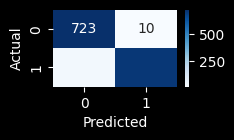



Confusion Matrix for Train Data:


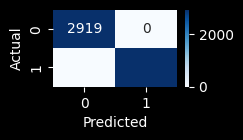

Test accuracy: 0.97
Train accuracy: 1.0
------------------------------------------------------------
------------------------------------------------------------
Confusion Matrix:
 Predicted    0    1   All
Actual                   
0.0        723   10   733
1.0         27  701   728
All        750  711  1461

Test report:
              precision    recall  f1-score   support

         0.0       0.96      0.99      0.98       733
         1.0       0.99      0.96      0.97       728

    accuracy                           0.97      1461
   macro avg       0.97      0.97      0.97      1461
weighted avg       0.97      0.97      0.97      1461

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

Train report:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      2919
         1.0       1.00      1.00      1.00      2924

    accuracy                           1.00      5843
   macro avg       1.00      1.00      1.00      5843


In [ ]:
metrics("XGBCLASSIFIFER",y_train,y_test,train_pred,test_pred)

In [ ]:
param_grid = {
    'n_estimators': [50,100,200,300],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [3, 4, 5],
    'subsample': [0.8, 0.9, 1.0],
    'colsample_bytree': [0.8, 0.9, 1.0],
    'alpha': [0, 0.1, 1, 2],  # L1 regularization term (alpha)
    'lambda': [0, 0.1, 1, 2]  # L2 regularization term (lambda)
}


In [ ]:

kf = KFold(n_splits=5, shuffle=True, random_state=4305)

In [ ]:


# Get the number of CPU cores
num_cpus = os.cpu_count()

print(f"Number of CPU cores in your laptop: {num_cpus}")


Number of CPU cores in your laptop: 8


In [ ]:
xgb_model = XGBClassifier(objective='binary:logistic')
grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, scoring='accuracy', cv=5,verbose=3,n_jobs=8)
grid_search.fit(x_train, y_train)

Fitting 5 folds for each of 5184 candidates, totalling 25920 fits
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.868 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.872 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.873 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.872 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.891 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.914 total time=   0.5s
[CV 4/5] END alpha=0, co

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.872 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.871 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.873 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.878 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.895 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.887 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_e

[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.868 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.871 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.877 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.891 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.890 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.924 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_e

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.872 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.878 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.872 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.880 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.888 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.892 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_e

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.878 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.872 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.876 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.873 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.891 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.890 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_e

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.872 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.868 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.880 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.874 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.888 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.893 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_e

[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.875 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.868 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.874 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.880 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.891 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.888 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_e

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.934 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.930 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.953 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.970 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, ma

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.944 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.951 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, m

[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.951 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.954 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.961 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.972 total time=   0.9s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.948 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.952 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.950 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.958 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.954 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.966 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.966 total time=   0.8s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, m

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.952 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.963 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.967 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_dep

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.970 total time=   0.8s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.975 total time=   0.8s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.935 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.956 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.947 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_de

[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.968 total time=   0.8s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.973 total time=   0.8s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.868 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.867 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.876 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.880 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_est

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.902 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.908 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.920 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.919 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.939 total time=   0.8s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.933 total time=   0.8s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n

[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.890 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.915 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.917 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.906 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.910 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.909 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_est

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.939 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.942 total time=   0.8s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.952 total time=   1.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.949 total time=   1.0s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.942 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.934 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n

[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.944 total time=   1.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.914 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.902 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.900 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.942 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.932 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_es

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.934 total time=   0.8s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.933 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.918 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.918 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.940 total time=   0.7s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.935 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_

[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.936 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.938 total time=   0.7s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.946 total time=   1.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.956 total time=   1.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.906 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.942 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.951 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.971 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.958 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.961 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.946 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_

[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.934 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.940 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.935 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.934 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.952 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.955 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators

[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.9s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.940 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.940 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.932 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.935 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.939 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.969 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.961 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.973 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.962 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.973 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.973 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimato

[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.965 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.968 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.958 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.950 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.956 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.947 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators

[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.952 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.963 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.962 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.967 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.976 total time=   0.9s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.974 total time=   0.8s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_est

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.977 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.965 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.966 total time=   0.9s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.977 total time=   0.8s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.872 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.872 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.973 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.979 total time=   0.9s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.967 total time=   0.8s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.878 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.871 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.874 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=

[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.910 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.910 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.889 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.888 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.894 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.919 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_

[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.920 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.930 total time=   0.8s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.951 total time=   1.1s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.952 total time=   1.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.898 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.900 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_e

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.920 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.914 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.928 total time=   0.8s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.939 total time=   0.8s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.948 total time=   1.1s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.952 total time=   1.5s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n

[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.943 total time=   1.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.902 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.901 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.902 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.932 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.957 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_es

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.957 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.960 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.948 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.930 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.927 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_e

[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.942 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.942 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.960 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.962 total time=   0.8s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.961 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.962 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.915 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.908 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.951 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.965 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.957 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_e

[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.953 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.963 total time=   0.7s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.970 total time=   0.9s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.973 total time=   0.9s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.935 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.950 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_est

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.964 total time=   0.7s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.961 total time=   1.0s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.932 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.935 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estima

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.956 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.949 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.957 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.976 total time=   0.8s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimato

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.963 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.965 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.969 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.966 total time=   0.9s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.965 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimat

[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.873 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.898 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.899 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.917 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.890 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.880 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_e

[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.926 total time=   1.1s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.956 total time=   1.4s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.955 total time=   1.5s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.901 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.902 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.906 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_es

[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.890 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.908 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.914 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.887 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.884 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.893 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_

[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.875 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.873 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.897 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.892 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.914 total time=   0.7s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.907 total time=   0.7s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.926 total time=   0.7s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.938 total time=   1.0s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.938 total time=   1.1s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.914 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.914 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.921 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, m

[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.912 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.920 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.929 total time=   0.9s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.932 total time=   1.0s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.950 total time=   1.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.957 total time=   1.4s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, 

[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.937 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.950 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.955 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.960 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.961 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.934 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, m

[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.968 total time=   0.8s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.7s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.942 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.953 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.950 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=

[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.932 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.957 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.962 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.970 total time=   0.8s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_dept

[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.956 total time=   0.8s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.975 total time=   1.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.969 total time=   1.0s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.958 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.943 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.958 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_

[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.973 total time=   0.8s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.966 total time=   0.7s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.962 total time=   1.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.973 total time=   1.0s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.952 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.950 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.960 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.962 total time=   0.8s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estima

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.972 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.963 total time=   0.8s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.971 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.975 total time=   1.0s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.973 total time=   0.9s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.867 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estim

[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.968 total time=   1.0s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.873 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.867 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.873 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.870 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.870 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_est

[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.901 total time=   0.8s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.906 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.920 total time=   1.1s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.921 total time=   1.1s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.909 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.908 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_

[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.934 total time=   1.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.952 total time=   1.8s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.898 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.896 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.898 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.900 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_est

[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.908 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.926 total time=   1.0s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.932 total time=   1.3s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.939 total time=   1.7s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.951 total time=   1.5s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.933 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n

[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.908 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.910 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.928 total time=   1.0s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.952 total time=   1.8s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.951 total time=   1.7s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.902 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_

[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.9s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.943 total time=   1.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.940 total time=   1.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.932 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.931 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, 

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.951 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.943 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.958 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.950 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, m

[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.979 total time=   1.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.966 total time=   1.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.939 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.933 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.934 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.958 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_dept

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.955 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.960 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.970 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.952 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_dept

[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.958 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.969 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.972 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.969 total time=   0.7s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.965 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.979 total time=   1.0s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_dept

[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.954 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.956 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.967 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.979 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.7s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.968 total time=   1.0s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth

[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.961 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.962 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.972 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.973 total time=   0.8s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.968 total time=   0.8s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.960 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_dept

[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.953 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.967 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.973 total time=   0.8s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.974 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.976 total time=   1.0s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.975 total time=   1.0s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.958 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.972 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.972 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.7s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.965 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.978 total time=   1.0s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.956 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.957 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.965 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.974 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.979 total time=   1.0s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.9s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0

[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.910 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.900 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.891 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.919 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.921 total time=   0.8s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.941 total time=   1.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, m

[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.938 total time=   1.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.954 total time=   1.5s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.953 total time=   1.5s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.908 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.900 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.908 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.958 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.929 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.949 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.939 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.960 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.962 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, m

[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.935 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.926 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.932 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.930 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.949 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.960 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.952 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.955 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.957 total time=   1.0s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.966 total time=   1.0s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.947 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, m

[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.944 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.950 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.965 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.967 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.961 total time=   0.9s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.953 total time=   1.0s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, 

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.935 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.955 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.943 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.947 total time=   0.9s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.960 total time=   0.8s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.9s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, m

[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.963 total time=   0.8s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.955 total time=   0.9s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.9s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.960 total time=   1.0s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.943 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.948 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, m

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.933 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.932 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.951 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3,

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.958 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.974 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.961 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.963 total time=   0.9s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.974 total time=   0.8s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.973 total time=   1.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_dept

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.876 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.872 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.870 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.892 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.891 total time=   0.8s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.909 total time=   0.9s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, m

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.873 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.872 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.892 total time=   0.8s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.889 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.915 total time=   1.0s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.898 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, m

[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.889 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.890 total time=   0.8s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.910 total time=   0.9s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.918 total time=   1.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.887 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.892 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, m

[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.871 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.889 total time=   0.8s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.891 total time=   0.7s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.910 total time=   1.0s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.909 total time=   1.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.887 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, m

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.892 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.915 total time=   0.9s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.917 total time=   1.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.893 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.892 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.887 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learnin

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.902 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.904 total time=   1.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.9s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.936 total time=   1.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.925 total time=   1.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.914 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learnin

[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.894 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.888 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.890 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.923 total time=   1.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.918 total time=   0.8s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.934 total time=   1.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learnin

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.942 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.959 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.958 total time=   1.0s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.961 total time=   1.0s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.942 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learnin

[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.927 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.931 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.960 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.950 total time=   0.7s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.950 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.7s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.971 total time=   1.0s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.966 total time=   0.9s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.936 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.941 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.957 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.978 total time=   1.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.965 total time=   1.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.937 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.935 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=

[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.962 total time=   0.9s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.9s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.971 total time=   1.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.975 total time=   1.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.930 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.958 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.7s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.956 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.966 total time=   0.9s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.966 total time=   0.8s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.954 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.966 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_dept

[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.968 total time=   1.6s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.969 total time=   2.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.962 total time=   1.8s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.933 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.945 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_d

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.972 total time=   0.9s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.943 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.941 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.958 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.959 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.970 total time=   0.8s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.977 total time=   0.8s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.967 total time=   1.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.965 total time=   1.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.878 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.869 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.873 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.871 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.870 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.874 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.871 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.873 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.876 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_de

[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.890 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.915 total time=   0.9s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.917 total time=   0.9s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.929 total time=   1.6s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.916 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.915 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, ma

[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.893 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.906 total time=   0.8s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.902 total time=   0.8s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.931 total time=   1.5s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.923 total time=   1.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.912 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, m

[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.927 total time=   1.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.935 total time=   1.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.952 total time=   1.6s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.952 total time=   1.8s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.934 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, 

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.934 total time=   1.8s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.950 total time=   2.8s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.899 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.897 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.904 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.902 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.893 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.904 total time=   1.0s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.908 total time=   1.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.926 total time=   1.7s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.932 total time=   1.7s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.913 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, m

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.956 total time=   2.5s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.953 total time=   2.6s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.897 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.902 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.907 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.898 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.951 total time=   1.1s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.973 total time=   1.5s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.960 total time=   1.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.935 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.935 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, ma

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.969 total time=   1.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.936 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.937 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.958 total time=   0.7s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.955 total time=   0.9s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.970 total time=   1.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, ma

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.950 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.944 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.958 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.973 total time=   0.8s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.970 total time=   0.8s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.971 total time=   0.8s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.973 total time=   1.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.976 total time=   1.1s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.952 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.976 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.968 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_dept

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.968 total time=   1.0s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.966 total time=   1.1s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.949 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.946 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.950 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.969 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.972 total time=   1.0s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.948 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.944 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.7s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.957 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.972 total time=   0.8s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=

[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.9s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.961 total time=   1.0s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.957 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.961 total time=   0.8s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.961 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.972 total time=   0.8s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.956 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.961 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.955 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.974 total time=   1.1s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.967 total time=   1.0s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.966 total time=   1.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.872 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.887 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.890 total time=   0.8s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.910 total time=   1.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.909 total time=   1.2s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.880 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, m

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.917 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.926 total time=   1.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.928 total time=   1.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.948 total time=   1.7s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.950 total time=   1.8s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.902 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, m

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.875 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.878 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.920 total time=   1.0s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.917 total time=   0.9s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.926 total time=   1.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.924 total time=   1.6s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, m

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.936 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.945 total time=   0.7s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.950 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.962 total time=   1.0s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.914 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, ma

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.904 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.940 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.958 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.950 total time=   0.8s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.950 total time=   1.0s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.952 total time=   0.8s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, m

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.952 total time=   0.8s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.954 total time=   1.0s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.961 total time=   1.1s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.914 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.952 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, m

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.9s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.956 total time=   1.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.961 total time=   1.3s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.939 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.935 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, ma

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.963 total time=   1.0s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.955 total time=   1.1s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.914 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.929 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.917 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.956 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.946 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.964 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.955 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.965 total time=   1.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.959 total time=   1.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.967 total time=   2.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, m

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.964 total time=   1.0s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.958 total time=   1.1s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.969 total time=   1.7s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.966 total time=   1.1s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.953 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.943 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.965 total time=   0.8s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.966 total time=   1.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.965 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.946 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.947 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.955 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.969 total time=   1.5s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.953 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.948 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.943 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.962 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.959 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.969 total time=   1.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.977 total time=   1.8s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.965 total time=   1.7s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.871 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.874 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.887 total time=   0.7s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.976 total time=   1.2s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.967 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.950 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.954 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.950 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.972 total time=   1.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators

[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.890 total time=   1.1s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.890 total time=   1.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.911 total time=   2.0s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.908 total time=   2.0s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.906 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.915 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, ma

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.872 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.879 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.879 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.887 total time=   1.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.890 total time=   1.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.911 total time=   2.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, m

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.926 total time=   0.7s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.938 total time=   1.4s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.942 total time=   1.6s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.949 total time=   2.3s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.955 total time=   2.0s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.905 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, m

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.953 total time=   0.7s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.962 total time=   1.0s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.963 total time=   1.0s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.924 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.931 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.953 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, ma

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.947 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.7s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.956 total time=   0.7s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.959 total time=   1.0s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.947 total time=   1.0s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, 

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.950 total time=   1.9s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.901 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.932 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.955 total time=   0.7s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.967 total time=   1.0s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, m

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.967 total time=   1.6s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.948 total time=   0.6s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.957 total time=   1.0s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.950 total time=   0.9s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.965 total time=   1.5s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.967 total time=   1.4s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, m

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.950 total time=   1.1s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.940 total time=   0.8s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.964 total time=   1.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.950 total time=   1.6s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.928 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.931 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_e

[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.950 total time=   1.3s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.956 total time=   1.7s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.928 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.930 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.949 total time=   1.0s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.940 total time=   1.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_e

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.970 total time=   3.2s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.939 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.933 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.939 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.937 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators

[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.966 total time=   0.7s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.955 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.960 total time=   1.0s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.973 total time=   1.1s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.965 total time=   1.5s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.962 total time=   1.5s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estima

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.874 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.879 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.892 total time=   0.9s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.887 total time=   0.9s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.915 total time=   1.5s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.913 total time=   1.4s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.974 total time=   1.4s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.966 total time=   2.0s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.976 total time=   1.9s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.872 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.876 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.872 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_est

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.867 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.873 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.873 total time=   0.6s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.891 total time=   1.0s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.910 total time=   1.5s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.914 total time=   1.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.918 total time=   1.5s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.917 total time=   1.3s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.945 total time=   2.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.933 total time=   2.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.927 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.926 total time=   0.9s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.975 total time=   2.7s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.962 total time=   3.1s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.873 total time=   1.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.872 total time=   0.8s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.891 total time=   1.7s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.895 total time=   1.6s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_e

[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.916 total time=   1.5s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.898 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.890 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.887 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.887 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.889 total time=   0.7s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_est

[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.909 total time=   1.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.907 total time=   1.7s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.937 total time=   2.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.926 total time=   2.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.920 total time=   0.6s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.917 total time=   1.0s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_

[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.956 total time=   1.0s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.958 total time=   0.9s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.959 total time=   1.8s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.954 total time=   1.6s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.915 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.952 total time=   0.7s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_

[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.956 total time=   1.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.972 total time=   1.6s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.961 total time=   1.5s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.962 total time=   2.0s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.934 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_esti

[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.956 total time=   1.0s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.974 total time=   1.7s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.961 total time=   1.5s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.960 total time=   2.0s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.967 total time=   2.1s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.932 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_es

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.956 total time=   1.5s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.960 total time=   1.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.970 total time=   1.9s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.967 total time=   2.0s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.948 total time=   1.0s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.943 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_es

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.957 total time=   1.5s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.958 total time=   1.5s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.973 total time=   1.8s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.960 total time=   2.0s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.941 total time=   0.8s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.945 total time=   0.9s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimato

[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.944 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.937 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.932 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.936 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.955 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.954 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3

[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.965 total time=   0.9s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.8s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.960 total time=   1.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.971 total time=   1.6s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.947 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_dept

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.972 total time=   1.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.966 total time=   1.4s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.944 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.947 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.943 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.966 total time=   0.9s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.978 total time=   3.0s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.973 total time=   2.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.876 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.877 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.887 total time=   1.0s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.891 total time=   1.0s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, 

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.911 total time=   1.4s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.908 total time=   1.4s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.891 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.893 total time=   0.7s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.902 total time=   0.7s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.908 total time=   1.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.892 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.894 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.893 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.886 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.892 total time=   0.7s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.887 total time=   0.7s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_est

[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.914 total time=   0.8s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.913 total time=   0.9s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.932 total time=   1.6s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.932 total time=   1.7s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.941 total time=   2.4s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.941 total time=   3.4s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.945 total time=   2.0s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.950 total time=   1.3s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.962 total time=   1.3s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.960 total time=   1.3s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.911 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.909 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_e

[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.906 total time=   1.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.932 total time=   1.6s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.924 total time=   1.8s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.919 total time=   0.6s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.915 total time=   0.8s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.920 total time=   1.0s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_

[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.919 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.916 total time=   0.9s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.911 total time=   1.0s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.930 total time=   2.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.937 total time=   1.7s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_e

[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.931 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.946 total time=   1.6s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.954 total time=   1.0s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.959 total time=   1.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.952 total time=   1.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.922 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_

[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.959 total time=   1.8s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.954 total time=   2.3s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.929 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.936 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.935 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimato

[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.935 total time=   0.6s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.955 total time=   1.4s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.970 total time=   1.9s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.961 total time=   2.4s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.961 total time=   2.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.959 total time=   1.9s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_e

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.979 total time=   2.6s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.961 total time=   2.0s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.933 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.929 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.927 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimato

[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.971 total time=   1.5s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.958 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.973 total time=   1.0s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.960 total time=   0.8s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.964 total time=   1.5s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.975 total time=   1.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimat

[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.889 total time=   0.8s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.910 total time=   1.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.917 total time=   1.1s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.875 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.878 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.893 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.970 total time=   1.0s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.971 total time=   0.9s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.973 total time=   1.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.975 total time=   1.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.962 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.949 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimato

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.867 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.867 total time=   0.7s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.870 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.872 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.853 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.891 total time=   1.0s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max

[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.950 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.960 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.963 total time=   1.0s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.972 total time=   0.9s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.973 total time=   1.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.980 total time=   1.3s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estima

[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.867 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.871 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.873 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.869 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.888 total time=   1.0s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.889 total time=   0.9s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, ma

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.878 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.923 total time=   1.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.917 total time=   1.0s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.927 total time=   1.7s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.924 total time=   1.9s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.914 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, m

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.941 total time=   3.4s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.950 total time=   2.7s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.933 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.933 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.947 total time=   0.8s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.8s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, 

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.940 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.956 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.968 total time=   0.7s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.961 total time=   0.8s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.962 total time=   1.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.971 total time=   1.1s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_dept

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.951 total time=   0.7s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.953 total time=   1.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.972 total time=   1.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.963 total time=   1.7s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.962 total time=   1.7s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.958 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, ma

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.939 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.930 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.945 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.943 total time=   0.7s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.952 total time=   1.0s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.933 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.943 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.9s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.955 total time=   0.9s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   1.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_e

[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.916 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.943 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.945 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.8s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.955 total time=   0.8s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.955 total time=   1.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_

[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.960 total time=   1.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.956 total time=   0.7s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.7s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.974 total time=   1.3s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.959 total time=   1.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_

[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.965 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.9s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.975 total time=   0.8s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.970 total time=   1.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.977 total time=   1.2s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.946 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimat

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.9s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.968 total time=   0.8s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.972 total time=   1.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.964 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.947 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.953 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimator

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.898 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.914 total time=   0.8s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.932 total time=   1.3s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.934 total time=   1.5s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.935 total time=   1.9s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.938 total time=   2.0s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.913 total time=   0.8s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.907 total time=   0.8s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.926 total time=   1.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.932 total time=   1.5s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.949 total time=   1.9s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.949 total time=   2.1s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n

[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.868 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.879 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.878 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.887 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.890 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.912 total time=   0.9s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.913 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.915 total time=   1.0s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.912 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.899 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.892 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.919 total time=   0.9s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.972 total time=   1.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.955 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.962 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.969 total time=   1.0s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.970 total time=   1.0s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimat

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.918 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.913 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.915 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.908 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.897 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.890 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_es

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.900 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.932 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.955 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.8s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.957 total time=   0.8s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.966 total time=   0.8s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.966 total time=   1.1s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.950 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.939 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.950 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.946 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_est

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.955 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.952 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.949 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.960 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.952 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.969 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimator

[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.970 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.973 total time=   1.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.962 total time=   1.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.865 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.874 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.878 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=

[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.948 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.966 total time=   0.9s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.961 total time=   1.0s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.972 total time=   1.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.944 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.961 total time=   1.1s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.948 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.945 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.950 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.963 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.955 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.971 total time=   1.2s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.963 total time=   1.1s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.943 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.948 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.965 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, m

[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.945 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.950 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.962 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.974 total time=   0.9s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.962 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.950 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_dept

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.978 total time=   1.1s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.965 total time=   1.5s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.963 total time=   1.4s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.868 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.876 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.872 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3,

[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.887 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.914 total time=   0.9s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.909 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.905 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.906 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.901 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_

[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.932 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.956 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.950 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.955 total time=   0.8s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.955 total time=   1.0s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.957 total time=   1.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.943 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.943 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.962 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.955 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.963 total time=   0.9s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.963 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_e

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.925 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.916 total time=   0.7s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.935 total time=   1.2s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.938 total time=   1.1s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.946 total time=   1.7s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.902 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.894 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.896 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.913 total time=   1.1s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.914 total time=   1.0s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.943 total time=   1.5s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.927 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_

[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.914 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.894 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.924 total time=   1.1s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.923 total time=   1.0s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.927 total time=   1.5s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.929 total time=   1.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.918 total time=   1.1s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.9s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.935 total time=   1.5s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.929 total time=   1.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.931 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.917 total time=   0.7s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_

[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.7s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.962 total time=   1.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.970 total time=   1.4s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.958 total time=   1.6s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.969 total time=   1.4s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.943 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_es

[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.952 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.958 total time=   0.8s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.966 total time=   0.8s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.958 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.956 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimat

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.979 total time=   1.6s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.962 total time=   1.4s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.877 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.874 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.889 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.889 total time=   0.8s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_e

[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.928 total time=   1.1s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.935 total time=   1.1s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.947 total time=   1.5s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.950 total time=   1.7s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.902 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.933 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.937 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.945 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.968 total time=   0.7s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.967 total time=   1.0s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimat

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.964 total time=   0.7s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.962 total time=   1.0s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.967 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.956 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.965 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimat

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.941 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.955 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.961 total time=   0.8s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.965 total time=   0.8s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.965 total time=   1.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimat

[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.950 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.979 total time=   1.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   1.1s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.955 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimat

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.913 total time=   0.8s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.935 total time=   1.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.924 total time=   1.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.912 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.920 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.911 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, m

[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.3s[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.940 total time=   1.6s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.940 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.7s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.944 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.963 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.974 total time=   1.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.961 total time=   1.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.935 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.936 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.961 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.975 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.964 total time=   1.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.962 total time=   1.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.953 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.955 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_dept

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.934 total time=   1.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.938 total time=   1.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.907 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.916 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.918 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.927 total time=   1.1s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.933 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.946 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.955 total time=   0.8s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.950 total time=   0.8s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.913 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.934 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.950 total time=   0.9s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.962 total time=   0.7s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.930 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.899 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.900 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.901 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.906 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.933 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.935 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_est


[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.959 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.962 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.942 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.942 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.955 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimato

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.961 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.961 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.975 total time=   1.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.876 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.878 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estim

[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.885 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.889 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.909 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.910 total time=   0.7s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.889 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.890 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.910 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.952 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.945 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.963 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.973 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.952 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.943 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.970 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.957 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimato

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.956 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.952 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.966 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.957 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.962 total time=   0.8s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.965 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estim

[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.970 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.961 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.972 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.976 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.976 total time=   0.9s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.867 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estim

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.959 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.969 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.977 total time=   0.8s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.963 total time=   0.9s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.854 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.867 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estim

[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.900 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.900 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.929 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.934 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_e

[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.934 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.939 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.935 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.948 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_est

[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.932 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.929 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.952 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.960 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.957 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimato

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.907 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.880 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.878 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.878 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.880 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.917 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, ma

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.952 total time=   0.2s[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.953 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.965 total time=   0.8s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.950 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.945 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_d

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.949 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.955 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.953 total time=   0.7s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.977 total time=   1.0s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.962 total time=   1.1s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.932 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max

[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.961 total time=   0.7s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.954 total time=   1.1s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.965 total time=   1.0s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.929 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.928 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_de

GridSearchCV(cv=5,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, device=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eval_metric=None,
                                     feature_types=None, gamma=None,
                                     grow_policy=None, importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None,...
                                     missing=nan, monotone_constraints=None,
                                     multi_strategy=None, n_estimators=None,
                                     n_jobs=None, num_parallel_tree=None,
                                     random_state=None, ...),
             n_jobs=8,
             param_grid={'alpha': [0, 0.1, 1, 2],
                         'colsample_bytree': [0.8, 0.9, 1.0],
                         'lambda': [0, 0.1, 1, 2],
                         'learning_rate': [0.01, 0.05, 0.1],
                         'max_depth': [3, 4, 5],
                         'n_estimators': [50, 100, 200, 300],
                         'subsample': [0.8, 0.9, 1.0]},
             scoring='accuracy', verbose=3)

In [ ]:
results = pd.DataFrame(grid_search.cv_results_).sort_values(by='mean_test_score', ascending=False)
results.head(20)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,param_colsample_bytree,param_lambda,param_learning_rate,param_max_depth,param_n_estimators,param_subsample,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
213,0.718600,0.013116,0.009348,0.001315,0,0.8,0.1,0.1,5,300,0.8,"{'alpha': 0, 'colsample_bytree': 0.8, 'lambda'...",0.979470,0.967494,0.975192,0.970034,0.979452,0.974328,0.004870,1
1941,1.300971,0.027708,0.019316,0.004070,0.1,0.9,0.1,0.1,5,300,0.8,"{'alpha': 0.1, 'colsample_bytree': 0.9, 'lambd...",0.979470,0.972626,0.975192,0.965753,0.978596,0.974328,0.004936,2
1511,1.049847,0.009717,0.017266,0.004144,0.1,0.8,0.1,0.1,5,300,1.0,"{'alpha': 0.1, 'colsample_bytree': 0.8, 'lambd...",0.978614,0.967494,0.976903,0.970034,0.977740,0.974157,0.004509,3
1077,1.019781,0.010307,0.011727,0.002214,0,1.0,0.1,0.1,5,300,0.8,"{'alpha': 0, 'colsample_bytree': 1.0, 'lambda'...",0.976903,0.968349,0.979470,0.968322,0.977740,0.974157,0.004825,4
94,0.532343,0.005972,0.008621,0.003536,0,0.8,0,0.1,4,300,0.9,"{'alpha': 0, 'colsample_bytree': 0.8, 'lambda'...",0.976903,0.969204,0.976048,0.969178,0.977740,0.973815,0.003813,5
1510,0.956926,0.022246,0.013446,0.003042,0.1,0.8,0.1,0.1,5,300,0.9,"{'alpha': 0.1, 'colsample_bytree': 0.8, 'lambd...",0.977759,0.967494,0.977759,0.967466,0.978596,0.973815,0.005181,6
1401,0.976462,0.033205,0.014274,0.003435,0.1,0.8,0,0.1,5,300,0.8,"{'alpha': 0.1, 'colsample_bytree': 0.8, 'lambd...",0.977759,0.968349,0.974337,0.969178,0.978596,0.973644,0.004241,7
215,0.692841,0.028913,0.009972,0.003149,0,0.8,0.1,0.1,5,300,1.0,"{'alpha': 0, 'colsample_bytree': 0.8, 'lambda'...",0.981180,0.968349,0.976903,0.966610,0.975171,0.973643,0.005427,8
309,0.643120,0.039097,0.013312,0.003117,0,0.8,1,0.1,4,300,0.8,"{'alpha': 0, 'colsample_bytree': 0.8, 'lambda'...",0.977759,0.965783,0.976048,0.969178,0.978596,0.973473,0.005076,9
2265,1.684728,0.156810,0.042703,0.026660,0.1,1.0,0,0.1,5,300,0.8,"{'alpha': 0.1, 'colsample_bytree': 1.0, 'lambd...",0.976048,0.968349,0.976903,0.968322,0.977740,0.973472,0.004228,10


In [ ]:
best_estimator = grid_search.best_estimator_
model_filename = "best_estimator_xgboost.pkl"

# Save the best estimator to a file using pickle
with open(model_filename, 'wb') as model_file:
    pickle.dump(best_estimator, model_file)

print(f"Best estimator saved to {model_filename}")

Best estimator saved to best_estimator_xgboost.pkl


In [ ]:
grid_search.best_estimator_

XGBClassifier(alpha=0, base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.8, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, lambda=0.1, learning_rate=0.1,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=5, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=300, n_jobs=None, ...)

In [ ]:
with open("best_estimator_xgboost.pkl", 'rb') as model_file:
        local_model = pickle.load(model_file)

In [ ]:
y_pred = local_model.predict(x_test)

In [ ]:
accuracy_score(y_test,y_pred)

0.973990417522245

**FEDERATED LEARNING**


In [ ]:
# Number of clients
num_clients = 3

# Define a function to split the data for each client
def split_data_for_client(client_id):
    start = int(client_id * len(x_train) / num_clients)
    end = int((client_id + 1) * len(x_train) / num_clients)
    client_X_train = x_train[start:end]
    client_y_train = y_train[start:end]
    return client_X_train, client_y_train

# Create dictionaries to store data
client_data = {}

# Split the data and store it for all clients
for client_id in range(num_clients):
    client_X_train, client_y_train = split_data_for_client(client_id)

    # Store the split data for each client
    client_data1 = {
        'X_train': client_X_train,
        'y_train': client_y_train,
    }
    client_data[client_id] = client_data1



In [ ]:
client_data

{0: {'X_train':       account_length  number_vmail_messages  total_day_minutes  \
  1471       -2.067842              -0.492932          -1.296475   
  3665        0.685545              -0.492932           0.485689   
  2577       -0.346975              -0.492932          -0.330124   
  982        -0.770573               2.776171          -1.625066   
  2799       -0.744098              -0.492932          -0.087323   
  ...              ...                    ...                ...   
  7112       -0.929422              -0.492932           1.859744   
  5466        0.076623              -0.492932           1.563687   
  2462        1.691590              -0.492932           0.262311   
  34          1.559215              -0.492932          -1.738374   
  4312        1.532741              -0.492932          -0.561894   
  
        total_day_calls  total_day_charge  total_eve_minutes  total_eve_calls  \
  1471        -1.379283         -1.296228          -0.714950        -0.256500   
  366

In [ ]:
num_clients = len(client_data)  # Number of local clients

for client_id in range(num_clients):
    grid_search.fit(client_data[client_id]['X_train'],client_data[client_id]['y_train'])
    model_filename = "XGBoost_Client" + str(client_id)+str('.pkl')

    with open(model_filename, 'wb') as model_file:
        pickle.dump(grid_search.best_estimator_, model_file)
    print(f"Local model for client {client_id} saved to {model_filename}")

Fitting 5 folds for each of 5184 candidates, totalling 25920 fits
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.971 total time=   0.8s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.953 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.952 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.961 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.972 total time=   0.9s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.974 total time=   1.3s
[CV 4/5] END alph

[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.873 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.872 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.870 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.893 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.888 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.911 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_

[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.914 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.920 total time=   0.9s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.932 total time=   1.0s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.948 total time=   1.8s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.936 total time=   1.8s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.900 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_


[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.954 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.959 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.966 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.950 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.947 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimat

[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.873 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.870 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.873 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.873 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.889 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.908 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_e

[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.962 total time=   1.5s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.962 total time=   1.1s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.867 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.876 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.887 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.888 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_es

[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.878 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.881 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.875 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.878 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.917 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.914 total time=   0.7s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_es

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.898 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.908 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.908 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.926 total time=   0.9s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.928 total time=   1.0s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.946 total time=   1.4s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.905 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.944 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.936 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.8s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.958 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.970 total time=   0.9s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.926 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.930 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.943 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.947 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimator

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.966 total time=   0.7s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.970 total time=   1.0s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.979 total time=   0.9s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.948 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimat

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.920 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.895 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.915 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.897 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.889 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.928 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_esti

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.928 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.949 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.954 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.946 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_est

[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.946 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.907 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=

[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.956 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.954 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.951 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimator

[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.915 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.946 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.931 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.961 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimat

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.879 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.918 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.920 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.907 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.926 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.913 total time=   0.8s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, m

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.938 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.964 total time=   1.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.903 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.920 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.890 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.943 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.961 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.8s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.959 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.949 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.936 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, ma

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.920 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.923 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.959 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.969 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.959 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_dept

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.872 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.905 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.900 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.918 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.905 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.882 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_

[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.913 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.902 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.936 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.913 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.897 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_e

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.956 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.949 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.941 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.925 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimat

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.943 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.928 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.941 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n

[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.954 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.913 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.961 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimato

[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.964 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.928 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.954 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.951 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimat

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.920 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.915 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.910 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.943 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.892 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.905 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_e

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.925 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.944 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.931 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_

[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.928 total time=   1.0s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.915 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.943 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.921 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.946 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.941 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.946 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.961 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.956 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.964 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimato

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.943 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.961 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.928 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimat

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.7s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.879 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.853 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.874 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estim

[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.938 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.923 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.933 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.961 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.936 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.943 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.956 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_e

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.921 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.956 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.959 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.954 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimat

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.902 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.910 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.923 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.887 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.925 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.871 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max

[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.892 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.926 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.943 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.920 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, m

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.903 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.913 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.925 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.918 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.910 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.938 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.907 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.931 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.933 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.944 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, ma

[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.969 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.931 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.936 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.956 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.928 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, m

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.961 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.962 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.949 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.961 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.931 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=

[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.920 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.908 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.923 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.936 total time=   0.7s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.923 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.903 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_e

[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.895 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.915 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.897 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.933 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.933 total time=   0.9s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.946 total time=   1.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.961 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.949 total time=   1.0s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.8s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.956 total time=   0.8s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.920 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_es

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.928 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.954 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimato

[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.933 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.972 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.928 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.944 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimato

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.877 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.869 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.918 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.908 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.900 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_

[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.910 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.897 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.887 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.895 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.928 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.905 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_

[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.918 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.925 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.918 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.944 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_

[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.928 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.943 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.962 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimat

[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.915 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.961 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.959 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.967 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.925 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimat

[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.933 total time=   0.7s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.918 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.892 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.915 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.907 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_e

[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.902 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.959 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.925 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n

[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.961 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.938 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_

[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.931 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.936 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.961 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.959 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimat

[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.928 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.954 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.931 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimat

[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.913 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.895 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.925 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.928 total time=   0.8s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.938 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.900 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, m

[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.910 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.928 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.903 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.938 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.923 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.8s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, m

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.944 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.903 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.926 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.907 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.946 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.931 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_

[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.964 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.925 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.962 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.933 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_dep

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.877 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.900 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.913 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.895 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.874 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.915 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_

[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.962 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.936 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.954 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.926 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.905 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_e

[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.915 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.959 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.936 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.951 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.946 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimator

[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.871 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.823 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.849 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.872 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.900 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_e

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.928 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.928 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimat

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.895 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.936 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.928 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.7s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.8s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.933 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n

[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.923 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.936 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.905 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.918 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.946 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.962 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_es

[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.954 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.944 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimat

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.879 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.861 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.874 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.874 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.854 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.889 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.861 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.856 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.892 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.897 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.869 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.918 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, m

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.915 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.923 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.889 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.903 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.900 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.943 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_d

[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.943 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.925 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.961 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.951 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, m

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.933 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.928 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_dept

[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.879 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.874 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.849 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.874 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.861 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.889 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_ra

[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.946 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.943 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.962 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.936 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.936 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learnin

[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.956 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.920 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.961 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.969 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning

[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.951 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.949 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.941 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.972 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.925 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning

[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.954 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.925 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.872 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.872 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.887 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.872 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.871 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.920 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.908 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.907 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, m

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.856 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.902 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.874 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.884 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.905 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.900 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, m

[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.956 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.961 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.944 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.961 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, 

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.915 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.928 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.931 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.954 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.931 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.964 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.972 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.944 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.959 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.964 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.918 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.879 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.913 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.907 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.882 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.879 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max

[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.967 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.923 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.907 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.941 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, ma

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.915 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.921 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.902 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.925 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.931 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.910 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.961 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_de

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.969 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.877 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.861 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.879 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.879 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max

[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.861 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.856 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.887 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.856 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.905 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.910 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, ma

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.936 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.915 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.931 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.931 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, ma

[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.967 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.954 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.941 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.928 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.931 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_dept

[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.961 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.946 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_dept

[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.931 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.972 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.859 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, ma

[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.887 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.882 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.895 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.941 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learni

[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.938 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.923 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.902 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.903 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.905 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.923 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.923 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.923 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.959 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learnin

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.962 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.933 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.946 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.962 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_

[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.874 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.874 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.861 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.882 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, 

[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.920 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.920 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.931 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.933 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, m

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.923 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.931 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.933 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.923 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, m

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.925 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.928 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.956 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_d

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.925 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.961 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_dept

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.895 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.938 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.933 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.903 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.931 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.910 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, m

[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.944 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.923 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.962 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.923 total time=   0.7s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.959 total time=   1.0s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, m

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.964 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.959 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.961 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.964 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5

[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.964 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.944 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.961 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.9s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.7s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.820 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_de

[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.872 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.856 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.823 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.895 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.864 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.892 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, m

[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.910 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.905 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.928 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.938 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.954 total time=   0.7s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, m

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.944 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.946 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.915 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.936 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, ma

[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.959 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.933 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.8s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.941 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_d

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.964 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.931 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_dept

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.869 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.913 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.897 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.933 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.918 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learnin

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.943 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.933 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.920 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.961 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.964 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.918 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.913 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.956 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.923 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learnin

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.928 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.954 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.941 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learnin

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.923 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.933 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.959 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.959 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.923 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.964 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.946 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.961 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.925 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.892 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.902 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.908 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.900 total time=   0.8s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.8s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, ma

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.900 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.925 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.913 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.889 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.8s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.936 total time=   0.9s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, ma

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.933 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.954 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.961 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.943 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_dept

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.851 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.879 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.890 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.861 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.918 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.897 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, 

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.902 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.895 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.910 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.915 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.915 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, ma

[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.908 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.889 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.887 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.910 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.869 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.925 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, m

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.892 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.918 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.923 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.936 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.902 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, m

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.961 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.962 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.900 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.943 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.933 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.954 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.964 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.962 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth

[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.962 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.951 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.920 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.931 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.938 total time=   0.7s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.7s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.918 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.951 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.972 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.918 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.961 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.920 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimat

[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.941 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.951 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimato

[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.928 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.920 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.925 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.959 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_esti

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.954 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.961 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.923 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimato

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.933 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.861 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.887 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.879 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.913 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.895 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.905 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, m

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.943 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.907 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.938 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.920 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, 

[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.946 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.925 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.861 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.849 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3

[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.921 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.903 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.936 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.7s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.897 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_e

[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.938 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.938 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.908 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.897 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.925 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.918 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.936 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.910 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.918 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.915 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.7s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.918 total time=   0.7s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.933 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.918 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.943 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.925 total time=   0.6s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.907 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.962 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_esti

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.923 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.944 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimat

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.879 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.869 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.902 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.913 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.889 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.907 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.915 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.951 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.910 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_e

[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.956 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.943 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.969 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.949 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.967 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimat

[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.964 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.961 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.918 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.961 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimat

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.879 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.861 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.851 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.874 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.877 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.861 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_esti

[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.967 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.923 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.967 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.854 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.895 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.851 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_est

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.959 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.946 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.936 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_es

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.923 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.928 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.923 total time=   1.0s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.959 total time=   0.7s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.920 total time=   1.0s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n

[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.972 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.951 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.946 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.961 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimat

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.954 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.864 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.879 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.872 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.905 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_dep

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.892 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.944 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.925 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.913 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.944 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, m

[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.946 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.961 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.931 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, m

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.969 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.928 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.920 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.944 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, m

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.949 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, ma

[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.961 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.856 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.844 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.869 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.902 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.915 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.856 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.879 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.856 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.887 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.874 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.903 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.900 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.910 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.895 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.936 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.7s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_

[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.923 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.6s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.956 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estim

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.962 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.923 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.7s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.967 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.959 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.923 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimato

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.869 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.920 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.918 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.895 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.885 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.902 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_e

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.897 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.920 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.897 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.928 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.928 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.936 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_e

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.941 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.918 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_es

[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.8s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.7s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.895 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.941 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_esti

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.962 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.920 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.944 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.928 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.954 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimat

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.936 total time=   0.8s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.8s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.905 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.895 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.920 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_es

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.913 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.956 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.946 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.961 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.905 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.946 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.956 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.918 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.946 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimato

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estima

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.915 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.964 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.944 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.920 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.967 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimat

[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.887 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.915 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.895 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.867 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.905 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.887 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, ma

[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.874 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.915 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.887 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.925 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.923 total time=   0.7s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, m

[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.915 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.943 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, m

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.918 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.961 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.959 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.954 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth

[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.887 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.869 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.925 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.895 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.921 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n

[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.869 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.913 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.900 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.882 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.910 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estim

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.941 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.946 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimat

[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.926 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.946 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.951 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.913 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.959 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimato

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.9s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.925 total time=   0.9s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.956 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_est

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.900 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.872 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.884 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.867 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.897 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.869 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_es

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.889 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.936 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.910 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n

[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.949 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.920 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.925 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimato

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.969 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.923 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.954 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.920 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimato

[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.925 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.944 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimato

[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.962 total time=   0.9s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.925 total time=   0.9s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.849 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.877 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.856 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_est

[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.897 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.931 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.936 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.897 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.923 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.918 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.931 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.936 total time=   0.9s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.962 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.961 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimato

[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.925 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.969 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.969 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.874 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.877 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, 

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.936 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.892 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.923 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.907 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, m

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.946 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.923 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, m

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.8s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.8s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.946 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, 

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.913 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.936 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.918 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.959 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max

[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.918 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.943 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.928 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.954 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.923 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth

[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.964 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.923 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.964 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.956 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_dept

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.943 total time=   0.8s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.900 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.938 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.9s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.956 total time=   0.7s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.931 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_est

[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.918 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.961 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.946 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.959 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.925 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estima

[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.874 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.918 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.869 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.892 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.928 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.907 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_est

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.964 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.923 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.856 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.877 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_esti

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.905 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.897 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.884 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.913 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.884 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.895 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_

[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.895 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.913 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.907 total time=   0.8s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.933 total time=   0.8s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.951 total time=   1.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.936 total time=   1.4s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.921 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.949 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.949 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_es

[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.877 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.861 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.884 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.872 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.874 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.923 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_

[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.933 total time=   1.0s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.946 total time=   1.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.900 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.885 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.920 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.890 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_est

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.959 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.923 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.941 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.913 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.897 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.905 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.946 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.925 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.7s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.7s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.954 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.961 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_esti

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.920 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.954 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.925 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.962 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.962 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimat

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.925 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.877 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.918 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.895 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.925 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.897 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, ma

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.923 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.7s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.7s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.949 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_

[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.908 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.915 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.900 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.869 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.920 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.915 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.961 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.925 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.923 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.959 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.918 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_dept

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.923 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.859 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.877 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.856 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3,

[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.887 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.877 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.907 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.885 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.928 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_e

[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.913 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.902 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.931 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_e

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.931 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.928 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.928 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.931 total time=   0.8s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.946 total time=   1.0s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.902 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.961 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.954 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.925 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estima

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.902 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.890 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.920 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.905 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.913 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.913 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.944 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.908 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_es

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.910 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.918 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.961 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.951 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.933 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.943 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.944 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimator

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.923 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.925 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.8s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.923 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.951 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_e

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.956 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.954 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.962 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimato

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.951 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.956 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.918 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.967 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimat

[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.946 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.962 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.928 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.920 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_

[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.956 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.956 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.923 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.961 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.944 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estima

[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.869 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.913 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.895 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.7s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.915 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.925 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, m

[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.900 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.928 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.931 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.918 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.931 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, 

[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.897 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.925 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.864 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.903 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.902 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.900 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_de

[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.961 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.941 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.910 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, ma

Local model for client 0 saved to XGBoost_Client 0
Fitting 5 folds for each of 5184 candidates, totalling 25920 fits
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.918 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.964 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.954 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsamp

[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.859 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.874 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.861 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.877 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.884 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.890 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_es

[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.923 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.920 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.915 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.910 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.900 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.949 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.944 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimat

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.905 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.931 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.961 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.959 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimat

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.923 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.949 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.946 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimat

[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.925 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.910 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.902 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.897 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.923 total time=   0.8s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_

[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.936 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.910 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.900 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.928 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.928 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_

[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.928 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.938 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.938 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n

[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.944 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.961 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.925 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.941 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.949 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimato

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.928 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.908 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.8s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.928 total time=   0.8s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.941 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.933 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.915 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_e

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.926 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.8s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.928 total time=   0.8s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.923 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.956 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.944 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.969 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_e

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.959 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.944 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.946 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.956 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimat

[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.962 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.964 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimat

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.921 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.923 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.936 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.933 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.918 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, m

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.938 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.925 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.969 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.926 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, m

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.946 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.944 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.969 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.859 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.969 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.943 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.943 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.969 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_dept

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.967 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.941 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.961 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.962 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.936 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth

[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.835 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.854 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.869 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.862 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.882 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.925 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_es

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.884 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.877 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.884 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.915 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_esti

[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.923 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.920 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.972 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.921 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.928 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_e

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.959 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.969 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.931 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.962 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimat

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.862 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.862 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.902 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.874 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.864 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.913 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_

[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.907 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.941 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.933 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.944 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.969 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.943 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.954 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.921 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.931 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.964 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.936 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.933 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.967 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.946 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.961 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.938 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.923 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estim

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.969 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.962 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.959 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.951 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimat

[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.843 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.856 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.846 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.877 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.871 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.903 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.928 total time=   1.0s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.910 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.944 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n

[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.954 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.926 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.959 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.938 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.969 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_e

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.874 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.867 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.905 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.885 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, m

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.885 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.864 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.915 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.859 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.874 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.890 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_d

[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.846 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.885 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.923 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.943 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.892 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.859 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, ma

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.931 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.918 total time=   0.8s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.8s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.915 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.944 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.969 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, 

[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.972 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.936 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.941 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.944 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, m

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.972 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.938 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.933 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.931 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_d

[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.941 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.956 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.838 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.859 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.913 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.920 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.923 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.897 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.908 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.900 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.959 total time=   0.7s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.926 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.923 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.931 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.954 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_e

[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.943 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.931 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.954 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.972 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.961 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.928 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.931 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.972 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estima

[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.964 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.938 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.972 total time=   1.0s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.972 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.889 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estim

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.903 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.887 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.869 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.907 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.885 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_

[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.964 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.964 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.923 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_

[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.8s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.908 total time=   0.8s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.905 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.913 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.915 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.925 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.944 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.928 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.936 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.972 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.7s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimat

[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.931 total time=   1.0s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.943 total time=   0.9s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.897 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.897 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.859 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.833 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_est

[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.861 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.895 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.877 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.908 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_

[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.938 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.956 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.926 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.928 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.938 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.964 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.928 total time=   1.0s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.933 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.944 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.938 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.946 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.964 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.946 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.938 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estima

[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.851 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.874 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.841 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.859 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.887 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.936 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, ma

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.925 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.944 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.956 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.903 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.905 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, ma

[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.969 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.936 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.920 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.931 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_

[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.962 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.931 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.943 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.851 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=

[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.949 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.972 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.874 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.897 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.872 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.841 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.877 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.887 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_e

[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.928 total time=   0.8s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.8s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.926 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.926 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.946 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.905 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.933 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_est

[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.946 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.969 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.7s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.969 total time=   0.7s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.956 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_es

[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.849 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.830 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.851 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.825 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.859 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.859 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_est

[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.905 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.897 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.900 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.913 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.908 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.928 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.969 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.936 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.956 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.923 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_

[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.943 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.943 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.918 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_e

[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.969 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.869 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.862 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.856 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.879 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_dep

[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.974 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.974 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.951 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.967 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimat

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.921 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.910 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.938 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.910 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.897 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.921 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, m

[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.969 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.936 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.956 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.949 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, ma

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.936 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.954 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.941 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.962 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.956 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_dept

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.879 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.921 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.926 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.923 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.907 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning

[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.943 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.920 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.872 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.877 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.915 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.921 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learnin

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.884 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.890 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.915 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.913 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learnin

[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.926 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.941 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.962 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.944 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learni

[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.905 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.959 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.908 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_

[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.933 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.936 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.944 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.859 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.867 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.877 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.902 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.864 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.910 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, ma

[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.933 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.900 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.951 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, ma

[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.944 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.943 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.928 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.967 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_d

[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.961 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.931 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.959 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.931 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_dept

[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.954 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.969 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.946 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.964 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.941 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_dept

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.969 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.869 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.856 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.889 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.872 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.851 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_de

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.835 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.874 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.843 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.867 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.866 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.941 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, m

[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.956 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.938 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.954 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, m

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.936 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.943 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.915 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_d

[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.956 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.943 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.943 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_dept

[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.910 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.872 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.903 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.913 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_d

[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.933 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.928 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.7s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.877 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.890 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.936 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.949 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.936 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, m

[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.969 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.926 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, ma

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.938 total time=   0.7s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.933 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.944 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, ma

[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.864 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.859 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.885 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.920 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.866 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.938 total time=   1.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_

[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.967 total time=   1.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.854 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.843 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.838 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.859 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.902 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rat

[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.946 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.908 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.923 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.928 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_

[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.933 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.944 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.941 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.949 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.972 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.946 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.938 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.959 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.956 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rat

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.962 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.838 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.859 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.862 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.869 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.861 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, 

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.910 total time=   0.8s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.879 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.867 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.861 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.859 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.866 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.900 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.908 total time=   0.7s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.915 total time=   0.7s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.910 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.931 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.900 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, m

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.938 total time=   0.8s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.905 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.931 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, ma

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.954 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.936 total time=   0.7s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.943 total time=   0.9s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, m

[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.974 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.864 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.851 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.887 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.849 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.864 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_de

[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.877 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.887 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.905 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.892 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.900 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_de

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.943 total time=   1.0s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.951 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.933 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.941 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.931 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.946 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_dept

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.928 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.923 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.933 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.964 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.964 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_dept

[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.967 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.938 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.921 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_dept

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.877 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.892 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.897 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.8s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.913 total time=   1.0s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.892 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, m

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.890 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.923 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.897 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.887 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.897 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_d

[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.882 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.928 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.944 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.938 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.974 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, m

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.972 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.964 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.936 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.941 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_dept

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.967 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.926 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.936 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.962 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.969 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.923 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.897 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.892 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.931 total time=   0.9s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.9s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learnin

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.923 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.926 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.959 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.8s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learnin

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.9s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.882 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.918 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.925 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.931 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.969 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.944 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.962 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.956 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.941 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.941 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.972 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.967 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.969 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.956 total time=   1.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.849 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.923 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.915 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.902 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, ma

[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.933 total time=   0.9s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.951 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.921 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.972 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.938 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_dep

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.9s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.867 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.854 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.887 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.864 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_de

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.964 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.944 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.941 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.936 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.936 total time=   0.9s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.8s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_de

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.913 total time=   0.7s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.882 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.887 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.908 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.915 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, m

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.923 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.941 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.972 total time=   0.8s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.949 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, ma

[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.944 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.944 total time=   0.7s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.897 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.915 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, ma

[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.867 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.864 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.887 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.897 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.877 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.905 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_e

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.887 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.879 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.902 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.867 total time=   0.7s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.890 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.887 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_

[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.903 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.915 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.933 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.931 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_es

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.8s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.928 total time=   0.8s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.928 total time=   1.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.951 total time=   1.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.908 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n

[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.915 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.959 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.9s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.962 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.967 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.938 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.943 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.7s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_esti

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.7s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.856 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.838 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.854 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3,

[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.867 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.866 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.905 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.890 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.923 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.918 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, ma

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.8s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.8s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.967 total time=   0.8s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.923 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.918 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_dep

[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.926 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.921 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.931 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.833 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.859 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.874 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.879 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.871 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.885 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_e

[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.933 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.869 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.843 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.864 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.928 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.866 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.879 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.926 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.923 total time=   0.7s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.8s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.908 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_e

[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.913 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.926 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.961 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.954 total time=   0.9s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_

[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.933 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.964 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.938 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.964 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.7s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.928 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_

[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.869 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.887 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.897 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.918 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.910 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_e

[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.892 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.905 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.903 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.908 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.897 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.943 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.936 total time=   0.8s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.8s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.951 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_es

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.931 total time=   0.8s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.8s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.936 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.933 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.961 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estim

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.923 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.931 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.961 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimat

[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.867 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.900 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.908 total time=   0.6s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.887 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.867 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_

[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.943 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.918 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.905 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.890 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.866 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.913 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.882 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.871 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.887 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.897 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.7s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.941 total time=   1.0s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.949 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.959 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.928 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.964 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimator

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.938 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.925 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.944 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.933 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimato

[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.931 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.908 total time=   0.8s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.923 total time=   0.7s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.889 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.913 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.892 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, ma

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.921 total time=   0.8s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.9s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.884 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.913 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.920 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, ma

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.913 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.905 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.905 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.936 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.913 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_

[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.943 total time=   0.8s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.9s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.946 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.933 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_d

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.8s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.921 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.954 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_dep

[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.918 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.936 total time=   0.8s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.905 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.869 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.890 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.874 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_est

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.913 total time=   0.8s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.956 total time=   0.7s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.928 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.936 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.933 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.926 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.936 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimato

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.944 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.969 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.944 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.923 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.956 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.926 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimato

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.849 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.838 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.902 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.885 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.882 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.897 total time=   0.9s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_

[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.910 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.889 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.887 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.892 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.918 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.926 total time=   1.0s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_e

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.903 total time=   0.8s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.926 total time=   0.7s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.889 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.892 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.892 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.943 total time=   0.7s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_

[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.908 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.915 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.892 total time=   0.7s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.7s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.926 total time=   0.9s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.928 total time=   1.0s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n

[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.969 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.962 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.959 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimat

[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.849 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.869 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.902 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.867 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.866 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.913 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_

[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.923 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.933 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.933 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.954 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.938 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.938 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.7s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.7s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.928 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.969 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estim

[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.961 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.944 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.959 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.969 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimat

[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.972 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.938 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.923 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.961 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimat

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.967 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.962 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.946 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.967 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.7s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimat

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.879 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.928 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.928 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, m

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.949 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.913 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.933 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.931 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, ma

[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.931 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.969 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.954 total time=   0.7s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.7s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.882 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.856 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.833 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.849 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.874 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.841 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.859 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.887 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_es

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.900 total time=   0.6s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.910 total time=   1.0s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.956 total time=   0.9s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.928 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.936 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n

[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.946 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.897 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.928 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.967 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_e

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.897 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.915 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.938 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_

[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.923 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.928 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.944 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.6s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.962 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.941 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.967 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.946 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.964 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimat

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.849 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.828 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.846 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.825 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.841 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.872 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_est

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.936 total time=   0.7s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.956 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.956 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.944 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.936 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_e

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.946 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.6s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.8s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.943 total time=   0.8s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_e

[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.7s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.943 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.841 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.864 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.869 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_es

[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.900 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.921 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.897 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.920 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.900 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.915 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_

[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.856 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.866 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.903 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.910 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.869 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.892 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_e

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.872 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.864 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.879 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.874 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.869 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.941 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.954 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.956 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.961 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_

[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.925 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.956 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.926 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.923 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.910 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.936 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.8s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.897 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.913 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, m

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.918 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.897 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.928 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.926 total time=   0.8s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.8s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, m

[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.967 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.913 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.941 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, m

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.951 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.956 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.931 total time=   0.8s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.938 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, ma

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.944 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.941 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.938 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.962 total time=   0.7s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.931 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, m

[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.851 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.866 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.897 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.910 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.887 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.897 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_e

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.856 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.887 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.923 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.885 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.889 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.877 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.925 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.933 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.964 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.936 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimato

[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.879 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.918 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.892 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.923 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.913 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.956 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.941 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.954 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.959 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimat

[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.882 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.913 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.890 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.923 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.903 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_

[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.879 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.879 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.874 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.882 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.910 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.921 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.943 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.915 total time=   0.9s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.920 total time=   0.8s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.874 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.905 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_e

[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.923 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.933 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.933 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.923 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_es

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.969 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.928 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.933 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.959 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.956 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimat

[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.910 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.923 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.928 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.954 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.920 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.903 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.926 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.967 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_e

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.9s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.923 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.918 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estima

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.951 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.967 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.931 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.943 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimat

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.933 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.923 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.946 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.936 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimato

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.964 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.933 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.936 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.954 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.969 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimat

[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.872 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.908 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.923 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.928 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, m

[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.885 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.933 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.877 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.889 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.882 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.864 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, m

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.962 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.928 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.941 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.887 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.887 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.905 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.933 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.892 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_e

[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.926 total time=   0.8s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.931 total time=   0.8s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.931 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.944 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.928 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.8s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.936 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.903 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.941 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.903 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.931 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_est

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.905 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.928 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.918 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_

[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.921 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.926 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.961 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.943 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n

[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.951 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.967 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estima

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.933 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.928 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.938 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.964 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimat

[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.961 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.944 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.895 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.931 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.961 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.944 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.967 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.941 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.964 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimat

[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.921 total time=   0.7s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.941 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.956 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.928 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.936 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimato

[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.933 total time=   0.7s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.7s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.869 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.844 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.849 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estim

[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.864 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.933 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.879 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.872 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.867 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.907 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_es

[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.890 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.866 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.905 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.889 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.859 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.877 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_

[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.913 total time=   0.8s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.9s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.905 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.918 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.936 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_e

[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.928 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.920 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.944 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.895 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.902 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_e

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.843 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.877 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.918 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.872 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.859 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, ma

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.933 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.926 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.905 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.956 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.956 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_

[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.944 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.933 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.918 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.923 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.964 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, m

[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.7s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.926 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, m

Local model for client 1 saved to XGBoost_Client 1
Fitting 5 folds for each of 5184 candidates, totalling 25920 fits
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.923 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.925 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.959 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;

[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.938 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.926 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.956 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.951 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.964 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.933 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.959 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.941 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.926 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.969 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_dept

[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.944 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.933 total time=   0.7s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.936 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.956 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_

[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.849 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.841 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.859 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.890 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.928 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.874 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.864 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.895 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.884 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.905 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.867 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.859 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_

[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.902 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.856 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.861 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.864 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.892 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.869 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n

[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.923 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.890 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.920 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.887 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.925 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.910 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_es

[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.892 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.915 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.925 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_

[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.961 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.913 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.931 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.926 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.944 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_

[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.923 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.926 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.941 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.928 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_e

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.908 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.920 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.931 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.918 total time=   0.9s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.910 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.915 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.962 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.7s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_esti

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.961 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.923 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estima

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.936 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.926 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.928 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.923 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.933 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.956 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=

[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.967 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.941 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimat

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.964 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.882 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.890 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, 

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.961 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.856 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.856 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.905 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.907 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.915 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.915 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.926 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, m

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.933 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.931 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.921 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.921 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.915 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.921 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_est

[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.920 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.921 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.905 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.915 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.918 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.928 total time=   0.8s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_

[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.920 total time=   0.8s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.936 total time=   1.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.882 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.889 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_est

[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.921 total time=   0.8s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.928 total time=   1.1s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.923 total time=   1.0s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.925 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.926 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.931 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.938 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.946 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimato

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.949 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.931 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.944 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.7s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.7s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.933 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.928 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.936 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=5, n_es

[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.921 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.921 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.920 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.918 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.918 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.928 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_

[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.921 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.954 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.954 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estima

[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.8s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.944 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.949 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.936 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimator

[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.931 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.943 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.951 total time=   1.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.936 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimat

[CV 2/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.956 total time=   1.0s
[CV 5/5] END alpha=0, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.8s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.853 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.867 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.872 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.897 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_es

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.949 total time=   1.0s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.936 total time=   0.9s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.936 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.928 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.933 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.936 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n

[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.910 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.900 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.925 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.938 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.941 total time=   0.9s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.933 total time=   0.9s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n

[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.959 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.962 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.944 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=5, n_estimat

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.913 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.905 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.905 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.910 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.921 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.910 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_

[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.915 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.910 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.933 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, ma

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.954 total time=   1.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.936 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.946 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.954 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.961 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.5s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_dep

[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.853 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.856 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.897 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3,

[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.877 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.889 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.902 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.925 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.900 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.938 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_es

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.918 total time=   0.9s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.907 total time=   0.9s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.887 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.887 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.900 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.895 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_es

[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.954 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.951 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimat

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.959 total time=   1.0s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.862 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.844 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.871 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.851 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.854 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estim

[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.892 total time=   1.1s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.926 total time=   1.6s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.913 total time=   1.6s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.905 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.908 total time=   0.8s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.897 total time=   0.9s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_est

[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.936 total time=   1.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.889 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.897 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.892 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.933 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.920 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_es

[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.905 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.928 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.905 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_

[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.913 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.910 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.925 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.928 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimator

[CV 5/5] END alpha=0, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.7s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.844 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.862 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.871 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.849 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.884 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_es

[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.905 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.933 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.962 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.959 total time=   0.5s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_

[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.936 total time=   0.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.962 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.943 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.941 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.5s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.9s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.9s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.910 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_es

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.4s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.6s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.946 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.946 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimato

[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.941 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.941 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.959 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.7s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimato

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.962 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.961 total time=   0.8s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.956 total time=   1.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.954 total time=   1.0s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.849 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.841 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.933 total time=   1.1s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.949 total time=   1.5s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.918 total time=   1.4s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.921 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.915 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.931 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, 

[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.959 total time=   0.7s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.962 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.936 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_de

[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.844 total time=   0.1s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.864 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.862 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.841 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.841 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.849 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_esti

[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.884 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.900 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.882 total time=   0.5s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.874 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.866 total time=   0.1s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.869 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_e

[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.900 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.889 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.921 total time=   0.8s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.905 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.915 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_es

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.913 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.931 total time=   0.3s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.921 total time=   0.3s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.6s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.6s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_e

[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.931 total time=   1.2s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.938 total time=   1.3s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.895 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.913 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.915 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.4s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_

[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.913 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.928 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.946 total time=   0.7s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.944 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.7s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.4s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.954 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.9s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.956 total time=   0.6s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.951 total time=   1.1s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.9s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estim

[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.889 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.874 total time=   0.1s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.897 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.900 total time=   0.1s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.903 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.925 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_est

[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.8s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.9s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.2s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.946 total time=   0.4s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.3s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.7s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_

[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.959 total time=   1.0s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.962 total time=   1.1s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.897 total time=   0.1s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.2s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.4s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estim

[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.2s
[CV 3/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.926 total time=   0.2s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.3s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.3s
[CV 1/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.6s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.5s
[CV 5/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimato

[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.895 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.869 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.877 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.872 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.882 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.900 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, 

[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.961 total time=   0.9s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.7s
[CV 4/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.951 total time=   1.0s
[CV 2/5] END alpha=0, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.951 total time=   1.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.874 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.882 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, 

[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.890 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.882 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.872 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.882 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.900 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, m

[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.949 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.951 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, ma

[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.949 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.941 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.962 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.962 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=

[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.915 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.892 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.910 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.920 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.920 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.7s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learnin

[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.9s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.941 total time=   1.0s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.918 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.915 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.933 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.933 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learni

[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.936 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.941 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.931 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.926 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learnin

[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.936 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.943 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learni

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.921 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.931 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.938 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learnin

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.925 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.944 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.946 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.961 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=0.1, learning

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.908 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.908 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.923 total time=   1.0s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.923 total time=   1.0s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.918 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.921 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, m

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.913 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.941 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.944 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.959 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.05, m

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.920 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.926 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.915 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=

[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.949 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.944 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.946 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5

[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.956 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.967 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.962 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.9s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.964 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.874 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_de

[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.877 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.874 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.872 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.900 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.910 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.910 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, m

[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.921 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.921 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.913 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.910 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.910 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, ma

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.869 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.890 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.910 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.905 total time=   0.7s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.897 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.915 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, m

[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.946 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.938 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.944 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_dept

[CV 5/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.962 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.954 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.877 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.864 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_de

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.925 total time=   1.0s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.938 total time=   0.9s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.907 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.921 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.943 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, m

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.900 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.915 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.923 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.921 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.938 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.943 total time=   1.0s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.01, m

[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.933 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.913 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.951 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.962 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.8s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, ma

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.961 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.931 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.941 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, m

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.959 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.946 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=

[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.923 total time=   0.7s[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.946 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth

[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.928 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.936 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.905 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_r

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.946 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learni

[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.964 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.959 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.944 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate

[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.964 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.8s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.967 total time=   0.8s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.853 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.964 total time=   0.9s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.8s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.849 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.843 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.874 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.856 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, m

[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.892 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.9s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.910 total time=   0.8s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.910 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.918 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.923 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, m


[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.931 total time=   1.0s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.923 total time=   1.0s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.900 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.879 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.928 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.910 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, m

[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.910 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.892 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.923 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.936 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.938 total time=   1.0s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.933 total time=   1.0s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, 

[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.7s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.7s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.851 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.854 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.856 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.877 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.959 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.8s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.872 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.874 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.869 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.921 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.903 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.910 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.931 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.931 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.938 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, m

[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.933 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.931 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.943 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.913 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.944 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, m

[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.944 total time=   0.7s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.938 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.913 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.941 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.936 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, m

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.949 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.946 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.946 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.959 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_dept

[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.1s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.936 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.943 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.931 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.951 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.4s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5

[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.951 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.6s
[CV 3/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.956 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.7s
[CV 5/5] END alpha=0.1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_dept

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.923 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.949 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.7s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.959 total time=   0.8s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, m

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.967 total time=   0.8s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.7s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.913 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.951 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.864 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.841 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.854 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.872 total time=   0.7s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.872 total time=   1.1s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.885 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learnin

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.946 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.951 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.972 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.964 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.8s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_d

[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.8s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.8s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.841 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.851 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.841 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.890 total time=   0.8s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.879 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.918 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.879 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.907 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rat

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.931 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.7s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.8s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learni

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.6s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.946 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.941 total time=   0.7s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.961 total time=   0.9s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.936 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.926 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=0.1, learning

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.887 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.890 total time=   0.3s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.897 total time=   0.5s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.897 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.8s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.920 total time=   0.8s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, 

[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.903 total time=   0.2s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.895 total time=   0.4s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.918 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.905 total time=   0.7s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.900 total time=   0.7s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.931 total time=   1.0s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, m

[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.3s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.944 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.954 total time=   0.7s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.6s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.913 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, m

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.5s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.7s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.7s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.936 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.928 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.933 total time=   0.4s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, ma

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.926 total time=   0.1s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.3s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.8s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_dept

[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.862 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.844 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.864 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.862 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.849 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.846 total time=   0.2s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_d

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.887 total time=   0.5s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.884 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.879 total time=   0.6s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.892 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.872 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.866 total time=   0.2s
[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.5s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.946 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.933 total time=   0.1s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.936 total time=   0.1s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.923 total time=   0.1s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.941 total time=   0.3s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4

[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.943 total time=   0.2s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.2s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.4s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.4s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_dep

[CV 3/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.3s
[CV 1/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.967 total time=   0.5s
[CV 4/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.6s
[CV 2/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.8s
[CV 5/5] END alpha=0.1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.7s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.877 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.902 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.928 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.920 total time=   0.7s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.907 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.913 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.925 total time=   0.8s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.900 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.879 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.931 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.908 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.936 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_e

[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.928 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.910 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.918 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.913 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.923 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.920 total time=   0.6s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.01, max_depth=5, n_e

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.946 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.944 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.926 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.959 total time=   0.7s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.921 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.921 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.923 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.928 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.900 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.923 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.895 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.915 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.892 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.928 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_d

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.949 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.943 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.8s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max

[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.936 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.943 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.943 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.944 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, m

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.946 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.961 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.956 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.951 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth

[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.956 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.946 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.964 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_dep

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.889 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.910 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.905 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.910 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.900 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.910 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.923 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.923 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.923 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.910 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.918 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.926 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.936 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.951 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.946 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.959 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimat

[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.874 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.869 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.877 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.862 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.874 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.887 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_e

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.869 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.874 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.918 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.905 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.902 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_e

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.920 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.933 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.946 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.928 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.944 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_e

[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.923 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.936 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_

[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.944 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.938 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.8s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.8s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.905 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=3, n_es

[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.931 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_

[CV 2/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.943 total time=   0.6s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.933 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.949 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.956 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimat

[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.946 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.956 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.8s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_esti

[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.8s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.933 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.8;, score=0.926 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_e

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.931 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.913 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.907 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=4, n_e

[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.895 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.879 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.905 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.882 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.897 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.879 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, m

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.874 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.853 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.856 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.871 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.872 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.884 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, ma

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.910 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.905 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.936 total time=   0.9s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.877 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.892 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.908 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.9;, score=0.913 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.915 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.920 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.910 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max

[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.936 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.949 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.7s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.956 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.933 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, m

[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.871 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.872 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.900 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.902 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.885 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.884 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.905 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.882 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.877 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.923 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.918 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.923 total time=   0.8s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_

[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.897 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.910 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.921 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.885 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.903 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.905 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.915 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.910 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.944 total time=   0.7s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_e

[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.933 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.943 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.956 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.7s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.959 total time=   0.7s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_e

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.941 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.946 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.943 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.6s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimat

[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.943 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.944 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.931 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimat

[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.903 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.882 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.877 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.889 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.921 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.928 total time=   0.7s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_

[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.944 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.8s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.8s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.949 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.943 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_est

[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.931 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.936 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.943 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.936 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimat

[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.933 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.941 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.954 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.954 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.8s
[CV 5/5] END alpha=1, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimat

[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.890 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.872 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.890 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.887 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.879 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.887 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_est

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.892 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.889 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.877 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.915 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.915 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_est

[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.907 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.882 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.879 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.867 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.869 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.869 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=4, n_es

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.943 total time=   0.4s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.907 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.908 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.951 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=4, n_e

[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.959 total time=   0.5s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.4s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.928 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=4, n_estimat

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.931 total time=   0.9s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.897 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.905 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.920 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, m

[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.923 total time=   0.3s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.915 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.928 total time=   0.8s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.8s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.936 total time=   0.9s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.918 total time=   0.9s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, 

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.936 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.944 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.920 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, m

[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.949 total time=   0.8s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.951 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.933 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.949 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_de

[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.941 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.946 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.946 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.954 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.938 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.943 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.954 total time=   0.5s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.943 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, max_dept

[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.849 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.887 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.900 total time=   0.4s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.879 total time=   0.5s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.890 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.869 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=4, n_e

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.897 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.895 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.908 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.905 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.6s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.933 total time=   0.9s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.05, max_depth=3, n_

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.6s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.954 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.946 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=5, n_estimato

[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.938 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.7s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.946 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.926 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.936 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=1, learning_rate=0.1, max_depth=4, n_estimator

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.913 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.9;, score=0.907 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.920 total time=   0.7s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.918 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.933 total time=   0.9s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.936 total time=   1.0s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.907 total time=   0.5s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.884 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.885 total time=   0.3s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.8;, score=0.915 total time=   0.6s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.910 total time=   1.0s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.921 total time=   0.8s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.01, max_depth=4, n_

[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.4s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.938 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.892 total time=   0.1s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.918 total time=   0.1s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.931 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_es

[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.954 total time=   0.7s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.9s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.931 total time=   0.2s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.907 total time=   0.2s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.941 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.7s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.05, max_depth=5, n_e

[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.941 total time=   0.3s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.3s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.941 total time=   0.5s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=1.0;, score=0.933 total time=   0.4s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.931 total time=   0.1s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimato

[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.1s
[CV 3/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.928 total time=   0.2s
[CV 1/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.2s
[CV 4/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.941 total time=   0.2s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.9;, score=0.946 total time=   0.6s
[CV 5/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.943 total time=   0.6s
[CV 2/5] END alpha=1, colsample_bytree=1.0, lambda=2, learning_rate=0.1, max_depth=4, n_estimato

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.921 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.895 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.889 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.915 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.928 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.928 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_es

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.933 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.928 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.943 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=4, n

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.936 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.944 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.943 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.944 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=4, n_estimat

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.956 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.954 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.938 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0, learning_rate=0.1, max_depth=3, n_esti

[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.884 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.903 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.879 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.900 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.908 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.895 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, m

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.928 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.903 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.9;, score=0.928 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.926 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.910 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=0.8;, score=0.910 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.01, max

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.926 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.946 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.938 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.936 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.918 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, m

[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.908 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.925 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.933 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.928 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.943 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.05, 

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.8;, score=0.928 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.8;, score=0.951 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.941 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.944 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.951 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.962 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.941 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.856 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.933 total time=   0.8s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.928 total time=   0.8s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.907 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.915 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.925 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n_

[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.920 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.913 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.920 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.918 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.944 total time=   0.8s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.928 total time=   0.8s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.05, max_depth=3, n

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.944 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.933 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.931 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.931 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.941 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=4, n_estimators

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.7s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.959 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.877 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.869 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.877 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.900 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_est

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.946 total time=   1.1s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.931 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.895 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.892 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.874 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.907 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=3, n_est

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.887 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.879 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=1.0;, score=0.905 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.9;, score=0.892 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.902 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.9;, score=0.885 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.01, max_depth=4, n_e

[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=1.0;, score=0.943 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.933 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.951 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.05, max_depth=5, n_

[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.941 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.951 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.9;, score=0.944 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.949 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.8;, score=0.941 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimator

[CV 3/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.949 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.959 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.959 total time=   0.6s
[CV 2/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.951 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=0.8, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.7s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.851 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=3, n_estim

[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.879 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.895 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.921 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.918 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.928 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_e

[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.944 total time=   0.8s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=1.0;, score=0.936 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.9;, score=0.931 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.923 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=3, n

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.928 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.933 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.938 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.941 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.8s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.959 total time=   0.7s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_e

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.944 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.926 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.946 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=1.0;, score=0.931 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.941 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators

[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.8;, score=0.938 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.938 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=1.0;, score=0.946 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0, learning_rate=0.1, max_depth=4, n_estimato

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.884 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=1.0;, score=0.908 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=0.8;, score=0.907 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=100, subsample=1.0;, score=0.903 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=0.9;, score=0.926 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.892 total time=   0.5s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.01, ma

[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.938 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.918 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.938 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.949 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.8;, score=0.954 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, ma

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.941 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=1.0;, score=0.933 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.9;, score=0.925 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.8;, score=0.931 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.936 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.8;, score=0.946 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.05, m

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=0.9;, score=0.943 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.8;, score=0.949 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.944 total time=   0.3s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.946 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_dept

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.941 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=0.1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.8s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.862 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.844 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.866 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.864 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=3, n_e

[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.920 total time=   0.7s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.915 total time=   0.7s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.913 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.910 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.910 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.902 total time=   0.8s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_

[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.8;, score=0.933 total time=   1.0s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=0.9;, score=0.923 total time=   0.8s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.8;, score=0.928 total time=   0.9s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.925 total time=   0.9s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.895 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.903 total time=   0.2s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_

[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.8;, score=0.946 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=200, subsample=0.9;, score=0.938 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.8;, score=0.933 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=3, n_estimators=300, subsample=0.9;, score=0.941 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=0.8;, score=0.920 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.936 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.05, max_depth=4, n_e

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.9;, score=0.949 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.944 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.933 total time=   0.1s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.8;, score=0.936 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=50, subsample=0.9;, score=0.936 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=4, n_estimators

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9;, score=0.856 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.8;, score=0.887 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.889 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.8;, score=0.879 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=300, subsample=0.9;, score=0.907 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_estimators=50, subsample=0.8;, score=0.887 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=4, n_

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.8;, score=0.954 total time=   0.6s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.5s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8;, score=0.956 total time=   0.8s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=1, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.954 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.866 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.851 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.01, max_depth=3, n_esti

[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.877 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.900 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.9;, score=0.921 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=1.0;, score=0.895 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=0.8;, score=0.915 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_estimators=100, subsample=1.0;, score=0.905 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=3, n_est

[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=0.9;, score=0.944 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.933 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.936 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.959 total time=   1.0s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.9;, score=0.951 total time=   0.7s
[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.944 total time=   1.1s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.05, max_depth=5, n_e

[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=0.8;, score=0.941 total time=   0.5s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.6s
[CV 4/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8;, score=0.946 total time=   0.8s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=1.0;, score=0.949 total time=   1.0s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=50, subsample=1.0;, score=0.946 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.944 total time=   0.4s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimat

[CV 2/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.944 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.954 total time=   0.9s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.862 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.844 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.9;, score=0.844 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=1.0;, score=0.862 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estim

[CV 3/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.9s
[CV 5/5] END alpha=2, colsample_bytree=0.9, lambda=2, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=1.0;, score=0.946 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8;, score=0.841 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0;, score=0.849 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=0.9;, score=0.892 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_estimators=200, subsample=1.0;, score=0.884 total time=   0.4s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=3, n_e

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=200, subsample=1.0;, score=0.895 total time=   0.8s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.01, max_depth=5, n_estimators=300, subsample=0.9;, score=0.928 total time=   1.1s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.921 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.879 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.892 total time=   0.1s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_estimators=50, subsample=0.8;, score=0.889 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=3, n_est

[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.944 total time=   1.0s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.946 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9;, score=0.918 total time=   0.1s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=1.0;, score=0.915 total time=   0.1s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=0.9;, score=0.951 total time=   0.2s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estimators=100, subsample=1.0;, score=0.931 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=3, n_estima

[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=50, subsample=1.0;, score=0.933 total time=   0.2s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.938 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.9;, score=0.946 total time=   0.4s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.956 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.7s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.9;, score=0.956 total time=   1.0s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.05, max_depth=5, n_

[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=0.9;, score=0.954 total time=   0.3s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=100, subsample=1.0;, score=0.936 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=0.9;, score=0.938 total time=   0.6s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0;, score=0.936 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9;, score=0.956 total time=   0.9s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_estimators=50, subsample=0.8;, score=0.862 total time=   0.1s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=3, n_e

[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=200, subsample=1.0;, score=0.923 total time=   0.5s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=0.8;, score=0.920 total time=   0.7s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=4, n_estimators=300, subsample=1.0;, score=0.921 total time=   0.7s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, subsample=1.0;, score=0.913 total time=   0.2s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=0.8;, score=0.905 total time=   0.4s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, subsample=1.0;, score=0.913 total time=   0.3s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.01, m

[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=50, subsample=1.0;, score=0.910 total time=   0.2s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=0.9;, score=0.941 total time=   0.3s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=100, subsample=1.0;, score=0.931 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=0.9;, score=0.936 total time=   0.5s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=200, subsample=1.0;, score=0.949 total time=   0.6s
[CV 1/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=4, n_estimators=300, subsample=0.9;, score=0.951 total time=   0.7s
[CV 4/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, m

[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=0.8;, score=0.936 total time=   0.3s
[CV 2/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=100, subsample=1.0;, score=0.933 total time=   0.4s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=0.8;, score=0.941 total time=   0.7s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=200, subsample=1.0;, score=0.954 total time=   0.7s
[CV 5/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=0.8;, score=0.943 total time=   1.0s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.05, max_depth=5, n_estimators=300, subsample=1.0;, score=0.951 total time=   0.9s
[CV 3/5] END alpha=2, colsample_bytree=1.0, lambda=0.1, learning_rate=0.1, m

Local model for client 2 saved to XGBoost_Client 2


In [ ]:
# Global model (initialized)
global_model = XGBClassifier()

client_models={}

for client_id, data in client_data.items():
    model_filename = "XGBoost_Client" + str(client_id) +str('.pkl')

    with open(model_filename, 'rb') as model_file:
        local_model=pickle.load(model_file)
    client_models[client_id]=local_model


client_model_params=[]
for client_id in range(3):
    client_model_params.append(client_models[client_id].get_params())

In [ ]:
client_models

{0: XGBClassifier(alpha=0.1, base_score=None, booster=None, callbacks=None,
               colsample_bylevel=None, colsample_bynode=None,
               colsample_bytree=1.0, device=None, early_stopping_rounds=None,
               enable_categorical=False, eval_metric=None, feature_types=None,
               gamma=None, grow_policy=None, importance_type=None,
               interaction_constraints=None, lambda=0.1, learning_rate=0.1,
               max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
               max_delta_step=None, max_depth=3, max_leaves=None,
               min_child_weight=None, missing=nan, monotone_constraints=None,
               multi_strategy=None, n_estimators=300, n_jobs=None, ...),
 1: XGBClassifier(alpha=0.1, base_score=None, booster=None, callbacks=None,
               colsample_bylevel=None, colsample_bynode=None,
               colsample_bytree=0.8, device=None, early_stopping_rounds=None,
               enable_categorical=False, eval_metric

In [ ]:
client_model_params

[{'objective': 'binary:logistic',
  'base_score': None,
  'booster': None,
  'callbacks': None,
  'colsample_bylevel': None,
  'colsample_bynode': None,
  'colsample_bytree': 1.0,
  'device': None,
  'early_stopping_rounds': None,
  'enable_categorical': False,
  'eval_metric': None,
  'feature_types': None,
  'gamma': None,
  'grow_policy': None,
  'importance_type': None,
  'interaction_constraints': None,
  'learning_rate': 0.1,
  'max_bin': None,
  'max_cat_threshold': None,
  'max_cat_to_onehot': None,
  'max_delta_step': None,
  'max_depth': 3,
  'max_leaves': None,
  'min_child_weight': None,
  'missing': nan,
  'monotone_constraints': None,
  'multi_strategy': None,
  'n_estimators': 300,
  'n_jobs': None,
  'num_parallel_tree': None,
  'random_state': None,
  'reg_alpha': None,
  'reg_lambda': None,
  'sampling_method': None,
  'scale_pos_weight': None,
  'subsample': 0.9,
  'tree_method': None,
  'validate_parameters': None,
  'verbosity': None,
  'alpha': 0.1,
  'lambda': 0.

In [ ]:
# Aggregate local gradients at the central server (simple averaging for illustration)
aggregated_params = {}

numeric_params = {}
non_numeric_params = {}


# Separate numeric and non-numeric parameters

for param in client_model_params[0]:
    if param in ['n_estimators','max_depth']:
        # Round off the number of iterations and max depth to the nearest integer
        numeric_params[param] = round(sum([local_params[param] for local_params in client_model_params]) / len(client_model_params))
    elif all(isinstance(local_params[param], (int, float)) for local_params in client_model_params):
        # Leave other numeric parameters as they are
        numeric_params[param] = sum([local_params[param] for local_params in client_model_params]) / len(client_model_params)
    else:
        non_numeric_params[param] = client_model_params[0][param]  # Assume non-numeric parameter is same for all clients



# Update aggregated gradients with numeric parameters
aggregated_params.update(numeric_params)

# Handle non-numeric parameters (you can customize this part based on your use case)
for param, value in non_numeric_params.items():
    # Handle non-numeric parameters (for example, set them to a specific value)
    aggregated_params[param] = value

# Update the global model with aggregated parameters
global_model.set_params(**aggregated_params)

global_model.fit(x_train,y_train)



# Save the trained global model to a pickle file
with open('global_model.pkl', 'wb') as file:
    pickle.dump(global_model, file)

In [ ]:
with open('global_model.pkl', 'rb') as global_model:
    global_model=pickle.load(global_model)

In [ ]:
y_pred=global_model.predict(x_test)
accuracy=accuracy_score(y_test,y_pred)
print(" Global model accuarcy is ",accuracy )

 Global model accuarcy is  0.9705681040383299


PATE


In [ ]:
teacher_models = []

for client_id, client_model in client_models.items():
    teacher_models.append(client_model)
teacher_models

[XGBClassifier(alpha=0.1, base_score=None, booster=None, callbacks=None,
               colsample_bylevel=None, colsample_bynode=None,
               colsample_bytree=1.0, device=None, early_stopping_rounds=None,
               enable_categorical=False, eval_metric=None, feature_types=None,
               gamma=None, grow_policy=None, importance_type=None,
               interaction_constraints=None, lambda=0.1, learning_rate=0.1,
               max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
               max_delta_step=None, max_depth=3, max_leaves=None,
               min_child_weight=None, missing=nan, monotone_constraints=None,
               multi_strategy=None, n_estimators=300, n_jobs=None, ...),
 XGBClassifier(alpha=0.1, base_score=None, booster=None, callbacks=None,
               colsample_bylevel=None, colsample_bynode=None,
               colsample_bytree=0.8, device=None, early_stopping_rounds=None,
               enable_categorical=False, eval_metric=None,

In [ ]:
def private_aggregate_teacher_predictions(num_teachers, epsilon):

    teacher_predictions = []

    for teacher_model in teacher_models:
        teacher_pred = teacher_model.predict(x_test)
        teacher_predictions.append(teacher_pred)

    final_aggregated_predictions = []

    for i in range(len(x_test)):
        class_counts = [0, 0]

        for teacher_prediction in teacher_predictions:
            teacher_prediction1 = teacher_prediction + np.random.uniform(low=0, high=epsilon)
            if teacher_prediction1[i]<=1:
                class_counts[0] += 1
            else:
                class_counts[1] += 1

        noisy_counts = [count + np.random.uniform(low=0, high=3) for count in class_counts]

        max_votes = max(noisy_counts)
        selected_classes = [j for j, vote in enumerate(noisy_counts) if vote == max_votes]
        final_prediction = np.random.choice(selected_classes)

        final_aggregated_predictions.append(final_prediction)

    aggregated_accuracy_with_noise = accuracy_score(y_test, final_aggregated_predictions)
    print(f"Aggregated predictions accuracy with noise: {aggregated_accuracy_with_noise}")

    # Aggregation without noise
    final_aggregated_predictions_no_noise = []

    for i in range(len(x_test)):
        class_counts = [0, 0]

        for teacher_prediction in teacher_predictions:
            class_counts[teacher_prediction[i]] += 1

        max_votes = max(class_counts)
        selected_classes = [j for j, vote in enumerate(class_counts) if vote == max_votes]
        final_prediction = selected_classes

        final_aggregated_predictions_no_noise.append(final_prediction)

    aggregated_accuracy_no_noise = accuracy_score(y_test, final_aggregated_predictions_no_noise)
    print(f"Aggregated predictions accuracy without noise: {aggregated_accuracy_no_noise}")

    return final_aggregated_predictions, aggregated_accuracy_with_noise, final_aggregated_predictions_no_noise, aggregated_accuracy_no_noise

num_teachers = 3
epsilon = 1.1
aggregated_predictions, aggregated_accuracy_with_noise, aggregated_predictions_no_noise, aggregated_accuracy_no_noise = private_aggregate_teacher_predictions( num_teachers, epsilon)
print("Final aggregated predictions with noise for all test data points:", aggregated_predictions)
print("Final aggregated predictions without noise for all test data points:", aggregated_predictions_no_noise)


Aggregated predictions accuracy with noise: 0.9315537303216974
Aggregated predictions accuracy without noise: 0.9685147159479809
Final aggregated predictions with noise for all test data points: [0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 

In [ ]:
x_train.head()

,account_length,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,...,state_state_VA,state_state_VT,state_state_WA,state_state_WI,state_state_WV,state_state_WY,area_code_area_code_area_code_415,area_code_area_code_area_code_510,international_plan_international_plan_yes,voice_mail_plan_voice_mail_plan_yes
1471,-2.067842,-0.492932,-1.296475,-1.379283,-1.296228,-0.714950,-0.256500,-0.714522,1.251114,1.404081,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3665,0.685545,-0.492932,0.485689,1.949783,0.485262,-1.202465,1.020327,-1.202393,-2.214046,0.517120,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2577,-0.346975,-0.492932,-0.330124,-1.009386,-0.329787,-0.217322,-0.522506,-0.217132,-2.346922,0.412772,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
982,-0.770573,2.776171,-1.625066,-0.111067,-1.624723,1.356478,0.807523,1.355953,-0.737875,-0.839408,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2799,-0.744098,-0.492932,-0.087323,-0.269594,-0.086986,-1.111435,2.297155,-1.111958,-0.025742,0.725817,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
x_train.columns


Index(['account_length', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'state_state_AL', 'state_state_AR',
       'state_state_AZ', 'state_state_CA', 'state_state_CO', 'state_state_CT',
       'state_state_DC', 'state_state_DE', 'state_state_FL', 'state_state_GA',
       'state_state_HI', 'state_state_IA', 'state_state_ID', 'state_state_IL',
       'state_state_IN', 'state_state_KS', 'state_state_KY', 'state_state_LA',
       'state_state_MA', 'state_state_MD', 'state_state_ME', 'state_state_MI',
       'state_state_MN', 'state_state_MO', 'state_state_MS', 'state_state_MT',
       'state_state_NC', 'state_state_ND', 'state_state_NE', 'state_state_NH',
       'state_state_NJ', 'state_state_NM', '

In [ ]:
with open("best_estimator_xgboost.pkl", 'rb') as model_file:
        local_model = pickle.load(model_file)

chosen_params=local_model.get_params()

In [ ]:
n_estimators = chosen_params['n_estimators']
learning_rate = chosen_params['learning_rate']
max_depth = chosen_params['max_depth']
subsample = chosen_params['subsample']
colsample_bytree = chosen_params['colsample_bytree']
alpha = chosen_params['alpha']
lambda_value = chosen_params['lambda']

# Printing the extracted values
print(f'n_estimators: {n_estimators}')
print(f'learning_rate: {learning_rate}')
print(f'max_depth: {max_depth}')
print(f'subsample: {subsample}')
print(f'colsample_bytree: {colsample_bytree}')
print(f'alpha: {alpha}')
print(f'lambda: {lambda_value}')

n_estimators: 300
learning_rate: 0.1
max_depth: 5
subsample: 0.8
colsample_bytree: 0.8
alpha: 0
lambda: 0.1


In [ ]:
x_test.iloc[0]

account_length                              -0.505824
number_vmail_messages                        1.099708
total_day_minutes                           -0.755837
total_day_calls                             -1.432125
total_day_charge                            -0.755402
                                               ...   
state_state_WY                               0.000000
area_code_area_code_area_code_415            1.000000
area_code_area_code_area_code_510            0.000000
international_plan_international_plan_yes    0.000000
voice_mail_plan_voice_mail_plan_yes          1.000000
Name: 2495, Length: 69, dtype: float64

In [ ]:
import pickle
import pandas as pd
float_numerical_columns = [
    'account_length', 'number_vmail_messages', 'total_day_minutes', 'total_day_calls',
    'total_eve_minutes', 'total_eve_calls', 'total_night_minutes', 'total_night_calls',
    'total_intl_minutes', 'total_intl_calls', 'number_customer_service_calls','total_day_charge','total_eve_charge',
    'total_night_charge','total_intl_charge'
]

string_columns=['state',      'area_code', 'international_plan', 'voice_mail_plan']

input_data = {
    'state': ['OH'],
    'account_length': [107],
    'area_code': ['area_code_415'],
    'international_plan': ['no'],
    'voice_mail_plan': ['yes'],
    'number_vmail_messages': [26],
    'total_day_minutes': [161.6],
    'total_day_calls': [123],
    'total_day_charge': [27.47],
    'total_eve_minutes': [195.5],
    'total_eve_calls': [103],
    'total_eve_charge': [16.62],
    'total_night_minutes': [254.4],
    'total_night_calls': [103],
    'total_night_charge': [11.45],
    'total_intl_minutes': [13.7],
    'total_intl_calls': [3],
    'total_intl_charge': [3.70],
    'number_customer_service_calls': [1]
}

input_data = pd.DataFrame(input_data)


# Load one-hot encoder instances
one_hot_encoder_dict = {}
for column in string_columns:
    with open(f'{column}_one_hot_encoder.pkl', 'rb') as file:
        one_hot_encoder_dict[column] = pickle.load(file)

# Initialize an empty DataFrame for one-hot encoded data
encoded_data_df = pd.DataFrame()

# Encode categorical variables using one-hot encoding
for column, encoder in one_hot_encoder_dict.items():
    encoded_data = encoder.transform(pd.DataFrame({column: input_data[column]}))
    new_columns = [f"{column}_{category}" for category in encoder.get_feature_names_out()]
    encoded_data_df = pd.concat([encoded_data_df, pd.DataFrame(encoded_data, columns=new_columns)], axis=1)

# Concatenate the one-hot encoded data to the input_data
input_data = pd.concat([input_data, encoded_data_df], axis=1)

# Drop the original categorical columns
input_data = input_data.drop(string_columns, axis=1)

# Load the standard scaler
with open('standard_scaler.pkl', 'rb') as file:
    scaler = pickle.load(file)

# Apply standard scaling to numerical variables
input_data[float_numerical_columns] = scaler.transform(pd.DataFrame(input_data[float_numerical_columns]))

with open('global_model.pkl', 'rb') as model_file:
    model = pickle.load(model_file)

# Make predictions
predictions = model.predict(input_data)
print("Predictions:", predictions)


Predictions: [0]


In [ ]:
import pickle
import pandas as pd
float_numerical_columns = [
    'account_length', 'number_vmail_messages', 'total_day_minutes', 'total_day_calls',
    'total_eve_minutes', 'total_eve_calls', 'total_night_minutes', 'total_night_calls',
    'total_intl_minutes', 'total_intl_calls', 'number_customer_service_calls','total_day_charge','total_eve_charge',
    'total_night_charge','total_intl_charge'
]

string_columns=['state',      'area_code', 'international_plan', 'voice_mail_plan']

input_data = {
    'state': ['IN'],
    'account_length': [65],
    'area_code': ['area_code_415'],
    'international_plan': ['no'],
    'voice_mail_plan': ['no'],
    'number_vmail_messages': [0],
    'total_day_minutes': [129.1],
    'total_day_calls': [137],
    'total_day_charge': [21.95],
    'total_eve_minutes': [228.5],
    'total_eve_calls': [83],
    'total_eve_charge': [19.42],
    'total_night_minutes': [208.8],
    'total_night_calls': [111],
    'total_night_charge': [9.40],
    'total_intl_minutes': [12.7],
    'total_intl_calls': [6],
    'total_intl_charge': [3.43],
    'number_customer_service_calls': [4]
}



input_data = pd.DataFrame(input_data)


# Load one-hot encoder instances
one_hot_encoder_dict = {}
for column in string_columns:
    with open(f'{column}_one_hot_encoder.pkl', 'rb') as file:
        one_hot_encoder_dict[column] = pickle.load(file)

# Initialize an empty DataFrame for one-hot encoded data
encoded_data_df = pd.DataFrame()

# Encode categorical variables using one-hot encoding
for column, encoder in one_hot_encoder_dict.items():
    encoded_data = encoder.transform(pd.DataFrame({column: input_data[column]}))
    new_columns = [f"{column}_{category}" for category in encoder.get_feature_names_out()]
    encoded_data_df = pd.concat([encoded_data_df, pd.DataFrame(encoded_data, columns=new_columns)], axis=1)

# Concatenate the one-hot encoded data to the input_data
input_data = pd.concat([input_data, encoded_data_df], axis=1)

# Drop the original categorical columns
input_data = input_data.drop(string_columns, axis=1)

# Load the standard scaler
with open('standard_scaler.pkl', 'rb') as file:
    scaler = pickle.load(file)

# Apply standard scaling to numerical variables
input_data[float_numerical_columns] = scaler.transform(pd.DataFrame(input_data[float_numerical_columns]))

with open('global_model.pkl', 'rb') as model_file:
    model = pickle.load(model_file)

# Make predictions
predictions = model.predict(input_data)

print("Predictions:", predictions)


Predictions: [1]
